# meowGAN
For my project I am going to construct a conditional generative adversial network (CGAN), which will be able to generate images of specific cat breeds. As for the first checkpoint I aim to create a generative adversial network (GAN), more specifically a deep convolutional GAN, capable of generating images of cats, without specifying the breed just yet. For the final submission I will modify this model into a conditional GAN and optimize its parameters for the best results. 

In [1]:
import os
import cv2

import pandas as pd
import numpy as np
from numpy.random import randn, randint
from matplotlib import pyplot as plt

from keras.models import Sequential
from keras.layers import Dense, Reshape, Flatten, Conv2D, Conv2DTranspose, LeakyReLU, BatchNormalization, Dropout, Input
from keras.initializers import RandomNormal
from tensorflow.keras.optimizers import Adam

from keras.datasets.cifar10 import load_data

During the whole process of creating this GAN model I followed this tutorial:


* https://machinelearningmastery.com/how-to-develop-a-generative-adversarial-network-for-a-cifar-10-small-object-photographs-from-scratch/

And also tried to include as many of the tips provided in these articles as possible:
* https://machinelearningmastery.com/how-to-code-generative-adversarial-network-hacks/
* https://medium.com/intel-student-ambassadors/tips-on-training-your-gans-faster-and-achieve-better-results-9200354acaa5.
* https://machinelearningmastery.com/practical-guide-to-gan-failure-modes/
* https://github.com/soumith/ganhacks
  * **Already included tips:** 1, 2, 3, 4, 5, 7, 10 (tracking the loss of both discriminator and generator helps notice failure to converge early on, will also add more metrics to keep track of)
  * **Not yet included but want to try:** 6, 9 (SGD for discriminator), 12 (basically included in CGAN, should help avoid mode collapse), 17

### Data preprocessing
The dataset I chose is the Cat breeds dataset from Kaggle, it contains images of different cats sorted into folders based on the cats breed. The folder name will therefore be used for creating the class label of the breed. However, during training I ran into a problem where the images were too variable and the model was not able to converge to a result that would actually look like a cat. For now I used a different dataset with only cat faces, which works fine for this model. 

For the final submission I will need to preprocess the first dataset so that it contains only the faces of the chosen cat breeds. I will handpick some significant cat breeds such as the British Shorthair to be able to tell the resemblance from the generated image. I would also like to use images with a higher resolution, the cat faces dataset contains only 64x64 images and I would like the final model to work with at least 128x128.

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
! mkdir ~/.kaggle

In [4]:
! cp /content/drive/MyDrive/kaggle.json ~/.kaggle/kaggle.json

In [5]:
! kaggle datasets download spandan2/cats-faces-64x64-for-generative-models
# ! kaggle datasets download ma7555/cat-breeds-dataset

 88% 84.0M/96.0M [00:02<00:00, 24.6MB/s]
100% 96.0M/96.0M [00:02<00:00, 36.3MB/s]


In [6]:
! unzip cats-faces-64x64-for-generative-models
# ! unzip cat-breeds-dataset

Streaming output truncated to the last 5000 lines.
  inflating: cats/cats/5499.jpg      
  inflating: cats/cats/55.jpg        
  inflating: cats/cats/550.jpg       
  inflating: cats/cats/5500.jpg      
  inflating: cats/cats/5501.jpg      
  inflating: cats/cats/5502.jpg      
  inflating: cats/cats/5503.jpg      
  inflating: cats/cats/5504.jpg      
  inflating: cats/cats/5505.jpg      
  inflating: cats/cats/5506.jpg      
  inflating: cats/cats/5507.jpg      
  inflating: cats/cats/5508.jpg      
  inflating: cats/cats/5509.jpg      
  inflating: cats/cats/551.jpg       
  inflating: cats/cats/5510.jpg      
  inflating: cats/cats/5511.jpg      
  inflating: cats/cats/5512.jpg      
  inflating: cats/cats/5513.jpg      
  inflating: cats/cats/5514.jpg      
  inflating: cats/cats/5515.jpg      
  inflating: cats/cats/5516.jpg      
  inflating: cats/cats/5517.jpg      
  inflating: cats/cats/5518.jpg      
  inflating: cats/cats/5519.jpg      
  inflating: cats/cats/552.jpg       

In [7]:
# Constant representing max breeds taken into the dataset, can be modified
maxBreeds = 10

# A list of possible classes
classes = os.listdir('cats/cats')[:maxBreeds]
# A list of all cat image paths
imagePaths = []

for directory, _, filenames in os.walk('cats'):
    for filename in filenames:
        imagePaths.append(os.path.join(directory, filename))

len(imagePaths)

31494

In [8]:
# Function to create a data frame from the wanted cat breeds
def createDataframe():
  images, labels = [], []

  for path in imagePaths:
    label = path.split(os.path.sep)[-2]

    #if label in classes:
    # Convert to RGB
    image = cv2.cvtColor(cv2.imread(path), cv2.COLOR_BGR2RGB)
    # Crop into a square
    minDim = min(image.shape[:2])
    image = image[0:minDim, 0:minDim]
    # Resize the image to 64x64
    image = cv2.resize(image, (64, 64))
    images.append(image)
    labels.append(label)
    #else:
     #break

  df = pd.DataFrame(list(zip(images, labels)), columns = ['Image', 'Label'])
  df = (df.sample(frac = 1).reset_index()).drop(columns = 'index')
  
  return df, np.asarray(images), np.asarray(labels)

In [9]:
df, images, labels = createDataframe()

In [10]:
# Function to plot images from dataset
def plotImages(df, n):
  plt.figure(figsize=(15, n * 3))
  
  for i in range(n * n):
    ax = plt.subplot(n, n, 1 + i)
    plt.imshow(df[i])
	
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)

  plt.show()

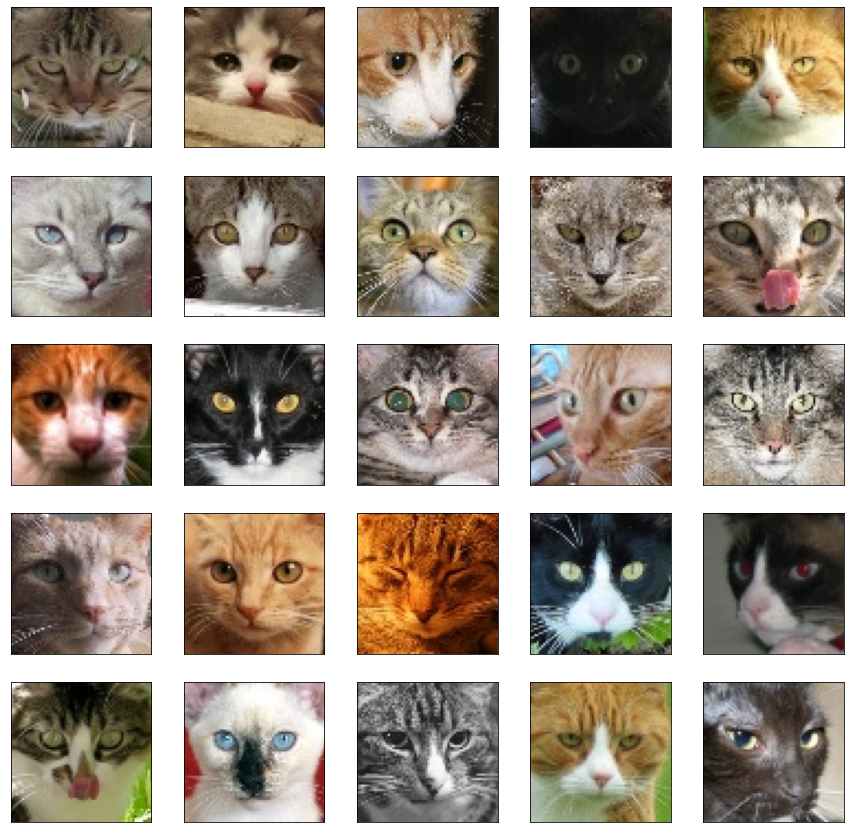

In [11]:
plotImages(df['Image'], 5)

In [12]:
def preprocessImages(images):
  data = images.astype('float32')
  data = (data - 127.5) / 127.5

  return data

In [13]:
data = preprocessImages(images)[:15000]
data.shape

(15000, 64, 64, 3)

In [14]:
data[0]

array([[[-0.19215687, -0.33333334, -0.49019608],
        [-0.15294118, -0.29411766, -0.4509804 ],
        [-0.05882353, -0.2       , -0.35686275],
        ...,
        [ 0.14509805, -0.01176471, -0.22352941],
        [ 0.01960784, -0.11372549, -0.31764707],
        [ 0.01176471, -0.12941177, -0.31764707]],

       [[-0.15294118, -0.29411766, -0.4509804 ],
        [-0.08235294, -0.22352941, -0.38039216],
        [-0.02745098, -0.16862746, -0.3254902 ],
        ...,
        [ 0.11372549, -0.01960784, -0.23921569],
        [ 0.04313726, -0.09803922, -0.28627452],
        [ 0.00392157, -0.13725491, -0.30980393]],

       [[-0.19215687, -0.33333334, -0.49019608],
        [-0.02745098, -0.16862746, -0.3254902 ],
        [-0.13725491, -0.2784314 , -0.4509804 ],
        ...,
        [ 0.15294118,  0.01960784, -0.18431373],
        [-0.03529412, -0.1764706 , -0.34901962],
        [-0.15294118, -0.28627452, -0.44313726]],

       ...,

       [[ 0.5686275 ,  0.41960785,  0.16862746],
        [ 0

### Discriminator model
The architecture of this model was taken from the aforementioned tutorial, with a few changes. I kept the recommended LeakyReLU with default 0.2 value, and also the unsampling of image using strided convolutions, instead of using pooling layers.


The number of downscaling layers was adapted to the input image resolution, and I played around with the number of filters in each layer. I also implemented the gaussian weight initialization of the parameters, which is recommended for convolutional GANs. Furthermore I tried to add the recommended batch normalization layer before every LeakyReLU layer, which should act in favour of stabilizing the training process, but adding these layers caused an output of noisy images. I am not yet sure why this happened, but plan to look into this later and figure out if there is a way these layers can be utilized in this model. Another option would be to use SeLU instead of LeakyReLU with Batch normalization layers, it should have a similar effect.

What I found the most beneficial for my model was to use doubling filters in the discriminator model and setting a bit higher learning rate for the generator than discriminator. The architecture of this model may not be final, besides wanting to look at enhancing the model's performance by batch normalization layers, I also plan to optimize the paramteres such as number of filters in a layer, learning rate, or batch size, after creating the full conditional GAN.




In [32]:
def discriminatorModel(inputShape):
  model = Sequential()

  model.add(Input(shape=inputShape))
  model.add(Conv2D(64, 3, strides=1, padding='same', kernel_initializer=initialWeights))
  model.add(LeakyReLU(alpha=0.2))
  # Downsample to 64x64
  # model.add(Conv2D(64, 3, strides=(2,2), padding='same', kernel_initializer=initialWeights))
  # model.add(LeakyReLU(alpha=0.2))
  # Downsample to 32x32
  model.add(Conv2D(128, 3, strides=2, padding='same', kernel_initializer=initialWeights))
  model.add(LeakyReLU(alpha=0.2))
  # Downsample to 16x16
  model.add(Conv2D(128, 3, strides=2, padding='same', kernel_initializer=initialWeights))
  model.add(LeakyReLU(alpha=0.2))
  # Downsample to 8x8
  model.add(Conv2D(256, 3, strides=2, padding='same', kernel_initializer=initialWeights))
  model.add(LeakyReLU(alpha=0.2))
  # # Downsample to 4x4
  model.add(Conv2D(512, 3, strides=2, padding='same', kernel_initializer=initialWeights))
  model.add(LeakyReLU(alpha=0.2))
  # Build classifier
  model.add(Flatten())
  model.add(Dropout(0.4))
  model.add(Dense(1, activation='sigmoid'))

  return model

initialWeights = RandomNormal(mean=0.0, stddev=0.02, seed=None)

discriminator = discriminatorModel((64, 64, 3))
discriminator.compile(loss='binary_crossentropy', optimizer=Adam(learning_rate=0.0002, beta_1=0.5), metrics=['accuracy'])
discriminator.summary()


Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_7 (Conv2D)           (None, 64, 64, 64)        1792      
                                                                 
 leaky_re_lu_15 (LeakyReLU)  (None, 64, 64, 64)        0         
                                                                 
 conv2d_8 (Conv2D)           (None, 32, 32, 128)       73856     
                                                                 
 leaky_re_lu_16 (LeakyReLU)  (None, 32, 32, 128)       0         
                                                                 
 conv2d_9 (Conv2D)           (None, 16, 16, 128)       147584    
                                                                 
 leaky_re_lu_17 (LeakyReLU)  (None, 16, 16, 128)       0         
                                                                 
 conv2d_10 (Conv2D)          (None, 8, 8, 256)        

### Generator model
The architecture of the generator model is also taken from the same source, with the exact same modifications applied as to the discriminator model. As for the generator model I would also like to experiment with the size of the latent space, and its effect on producing quality images. Currently the value is set to 128 as it seemed to yield better results than a lower number. Also, there is no need to compile this model since it will not be trained by itself, like discriminator model, but only together in the final GAN model.

In [31]:
def generatorModel():
	model = Sequential()
 
	# 256 4x4 feature maps
	model.add(Dense(4 * 4 * 256, input_dim=latentDimension))
	model.add(LeakyReLU(alpha=0.2))
	model.add(Reshape((4, 4, 256)))
	# Upsample to 8x8
	model.add(Conv2DTranspose(128, 4, strides=2, padding='same', kernel_initializer=initialWeights))
	model.add(LeakyReLU(alpha=0.2))
	# Upsample to 16x16
	model.add(Conv2DTranspose(128, 4, strides=2, padding='same', kernel_initializer=initialWeights))
	model.add(LeakyReLU(alpha=0.2))
	# Upsample to 32x32
	model.add(Conv2DTranspose(128, 4, strides=2, padding='same', kernel_initializer=initialWeights))
	model.add(LeakyReLU(alpha=0.2))
 	# Upsample to 64x64
	model.add(Conv2DTranspose(128, 4, strides=2, padding='same', kernel_initializer=initialWeights))
	model.add(LeakyReLU(alpha=0.2))
 	# # Upsample to 128x128
	# model.add(Conv2DTranspose(128, 4, strides=2, padding='same', kernel_initializer=initialWeights))
	# model.add(LeakyReLU(alpha=0.2))
	# 3 32x32 feature maps, one for each RGB channel
	model.add(Conv2D(3, 3, padding='same', activation='tanh'))
 
	return model

latentDimension = 128

generator = generatorModel()
generator.summary()


Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_2 (Dense)             (None, 4096)              528384    
                                                                 
 leaky_re_lu_10 (LeakyReLU)  (None, 4096)              0         
                                                                 
 reshape_1 (Reshape)         (None, 4, 4, 256)         0         
                                                                 
 conv2d_transpose_4 (Conv2DT  (None, 8, 8, 128)        524416    
 ranspose)                                                       
                                                                 
 leaky_re_lu_11 (LeakyReLU)  (None, 8, 8, 128)         0         
                                                                 
 conv2d_transpose_5 (Conv2DT  (None, 16, 16, 128)      262272    
 ranspose)                                            

### GAN
Again the model's architecture is taken from the same source. Here we only connect the two models together

In [47]:
def GAN():
	# We only update the discriminators weights when trained alone, not in conjunction with generator
	discriminator.trainable = False
	# Concat the models together
	model = Sequential()
 
	model.add(generator)
	model.add(discriminator)

	model.compile(loss='binary_crossentropy', optimizer=Adam(learning_rate=0.0008, beta_1=0.5))
 
	return model

gan = GAN()

### Helper functions



In [34]:
# Function to return n points in latent space
def latentPoints(n):
  points = randn(latentDimension * n).reshape(n, latentDimension)
  return points

In [45]:
# Function to draw a plot of generated images at given epoch
def drawPlot(n, m):
	points = latentPoints(n * m)

	# Generate images and scale them back
	X = generator.predict(points)
	X = (X + 1) / 2.0

	plt.figure(figsize=(15, n * 3))

	for i in range(n * m):
			ax = plt.subplot(n, m, 1 + i)
			plt.imshow(X[i, :, :])
	
			ax.get_xaxis().set_visible(False)
			ax.get_yaxis().set_visible(False)
	
	plt.show()

In [36]:
# Function to generate fake images from latent space, returns the images and an array of true labels in order to fool the discriminator
def fakeImages(n):
  points = latentPoints(n)

  X = generator.predict(points)
  y = np.zeros((n, 1))

  return X

In [37]:
# Function to pick a random sample of size n 
def randomSample(n):
  indices = np.random.choice(data.shape[0], n)
  
  X = data[indices]
  y = np.ones((n, 1))

  return X

EPOCH 1
D loss real: 0.662		D loss fake: 0.713		G loss: 0.687


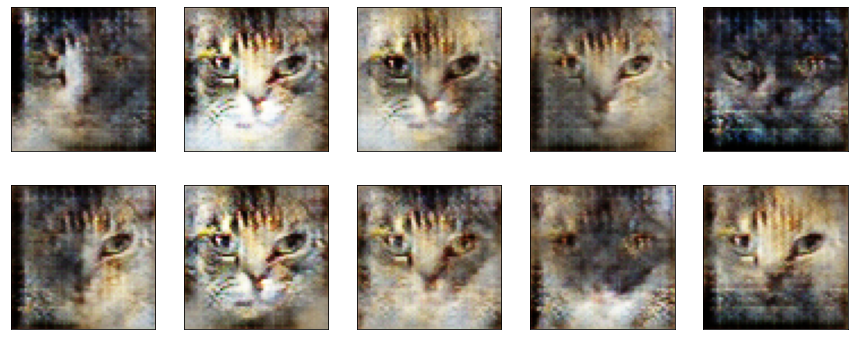

EPOCH 2
D loss real: 0.673		D loss fake: 0.688		G loss: 0.735


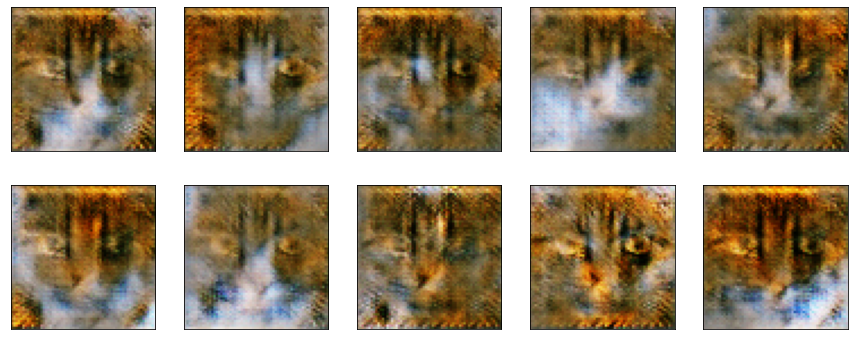

EPOCH 3
D loss real: 0.676		D loss fake: 0.724		G loss: 0.738


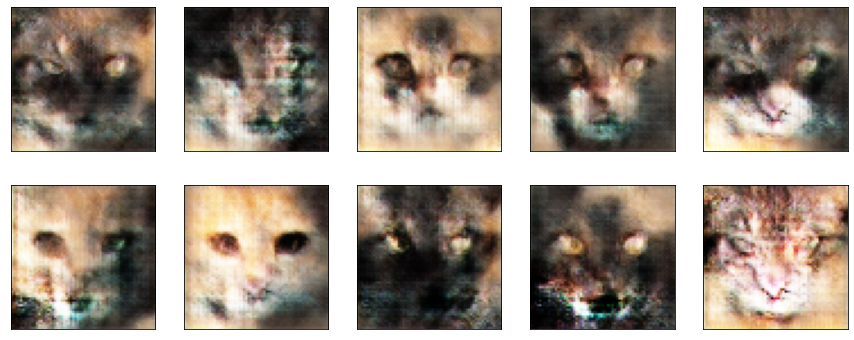

EPOCH 4
D loss real: 0.664		D loss fake: 0.669		G loss: 0.867


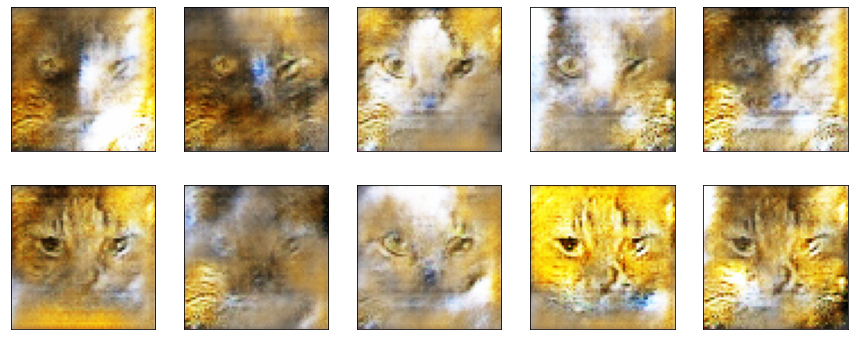

EPOCH 5
D loss real: 0.644		D loss fake: 0.639		G loss: 0.821


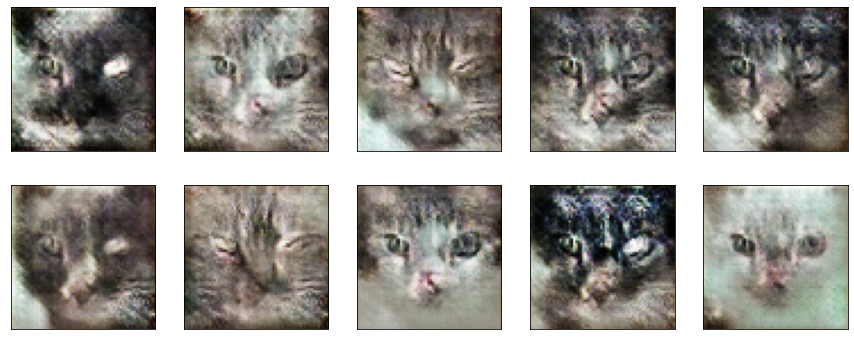

EPOCH 6
D loss real: 0.724		D loss fake: 0.646		G loss: 0.821


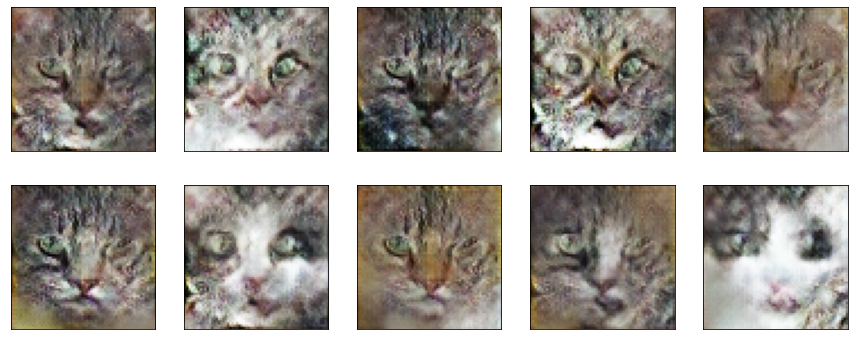

EPOCH 7
D loss real: 0.654		D loss fake: 0.770		G loss: 0.926


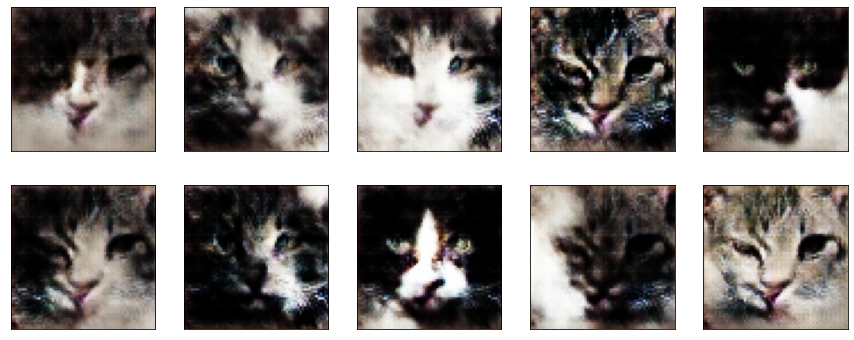

EPOCH 8
D loss real: 0.694		D loss fake: 0.663		G loss: 0.843


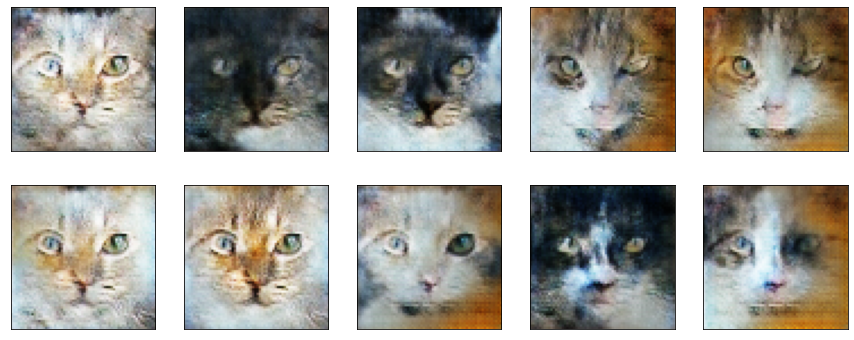

EPOCH 9
D loss real: 0.695		D loss fake: 0.646		G loss: 0.896


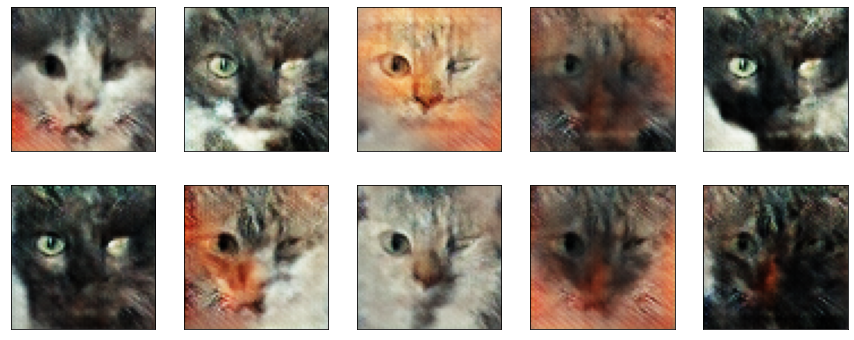

EPOCH 10
D loss real: 0.702		D loss fake: 0.594		G loss: 0.968


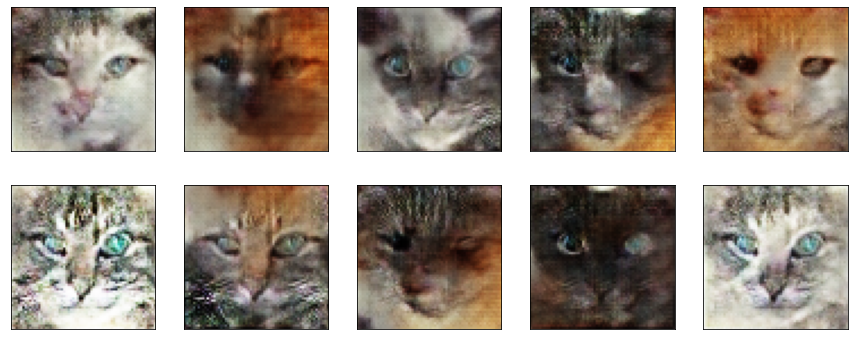

EPOCH 11
D loss real: 0.734		D loss fake: 0.630		G loss: 0.921


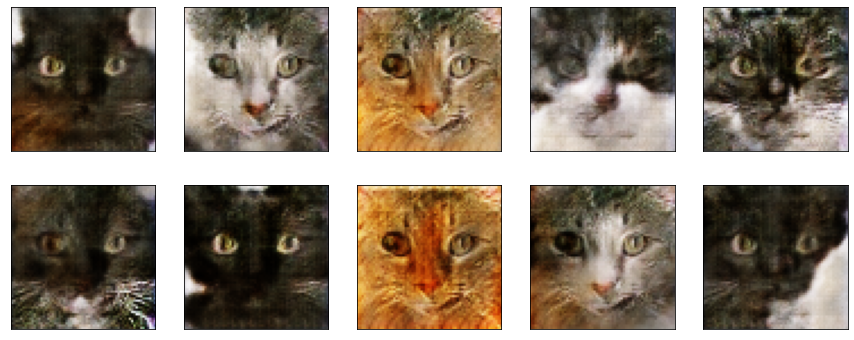

EPOCH 12
D loss real: 0.465		D loss fake: 0.439		G loss: 1.876


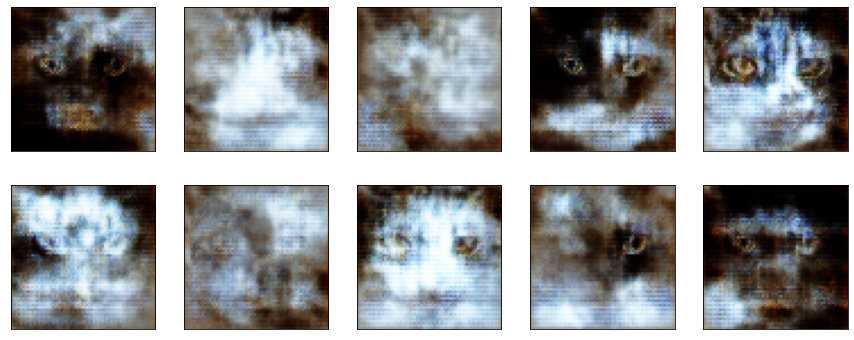

EPOCH 13
D loss real: 0.615		D loss fake: 0.365		G loss: 1.898


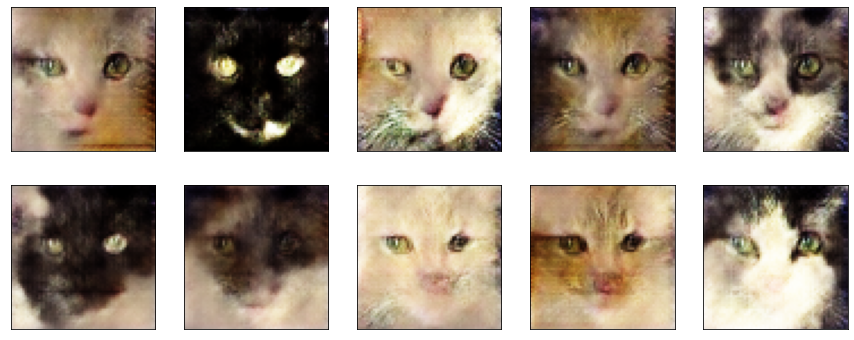

EPOCH 14
D loss real: 0.740		D loss fake: 0.461		G loss: 1.388


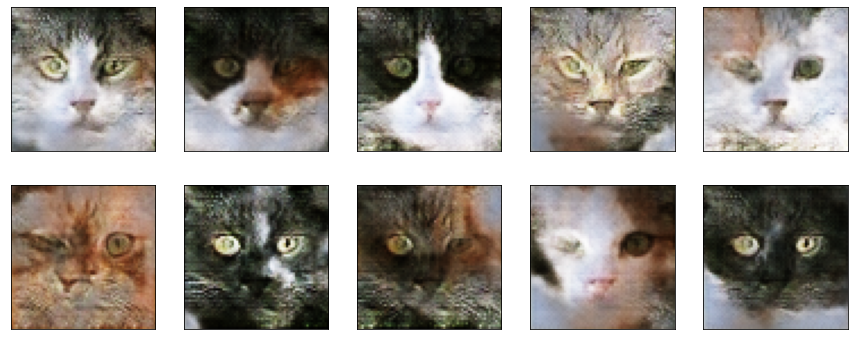

EPOCH 15
D loss real: 0.436		D loss fake: 0.712		G loss: 1.615


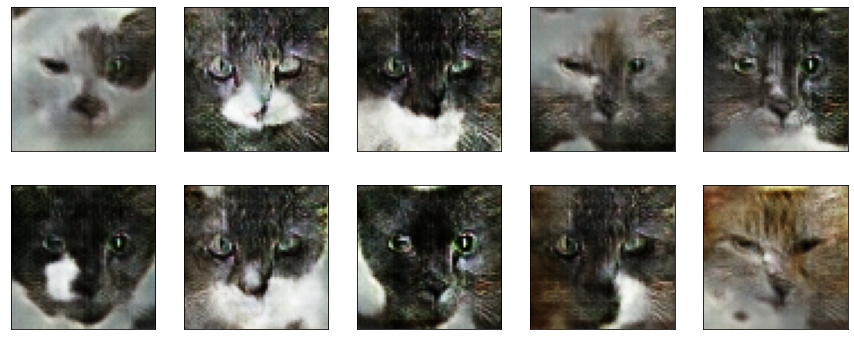

EPOCH 16
D loss real: 0.326		D loss fake: 0.940		G loss: 1.287


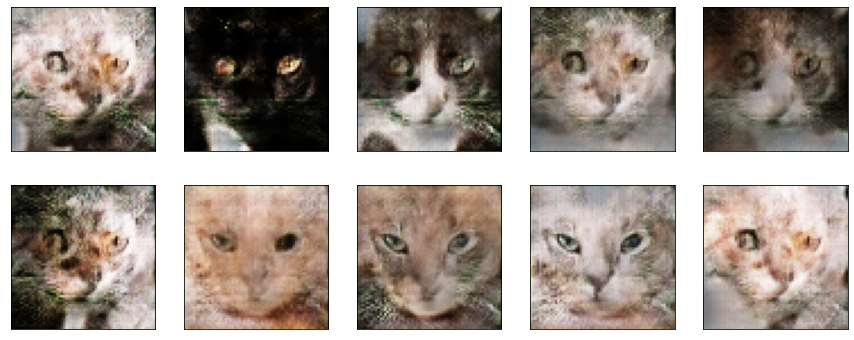

EPOCH 17
D loss real: 0.420		D loss fake: 0.539		G loss: 1.392


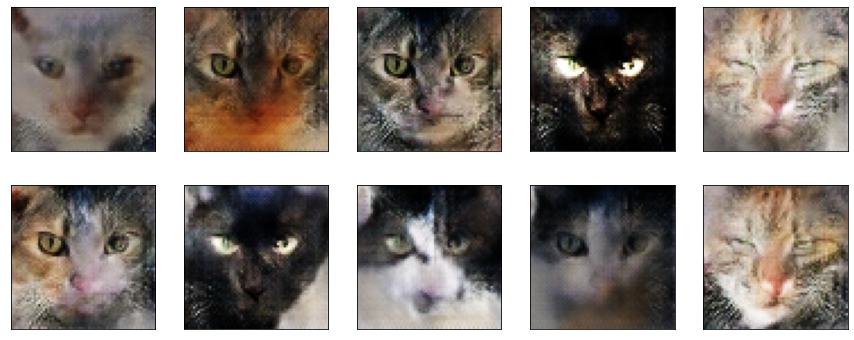

EPOCH 18
D loss real: 0.781		D loss fake: 0.535		G loss: 1.403


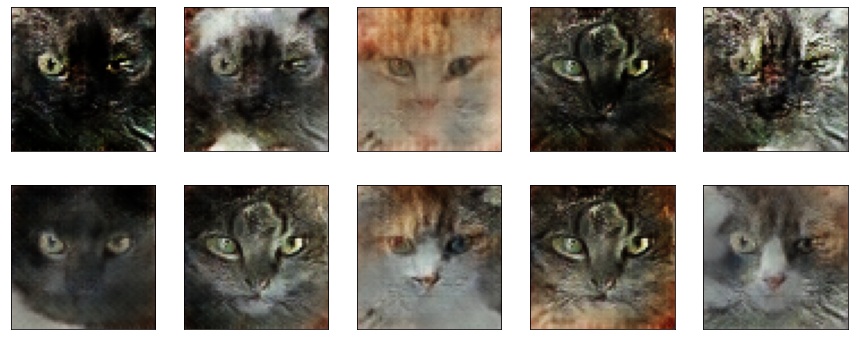

EPOCH 19
D loss real: 0.598		D loss fake: 0.387		G loss: 1.683


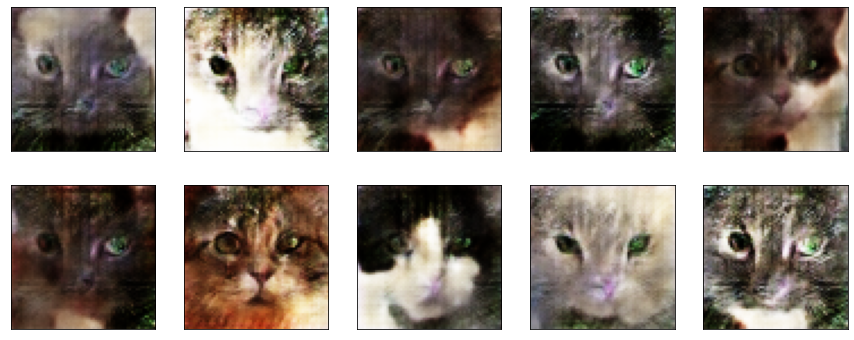

EPOCH 20
D loss real: 0.563		D loss fake: 0.432		G loss: 1.284


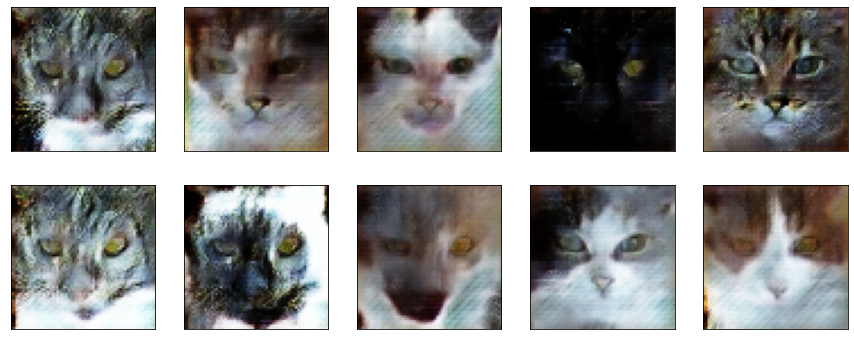

EPOCH 21
D loss real: 0.596		D loss fake: 0.375		G loss: 1.687


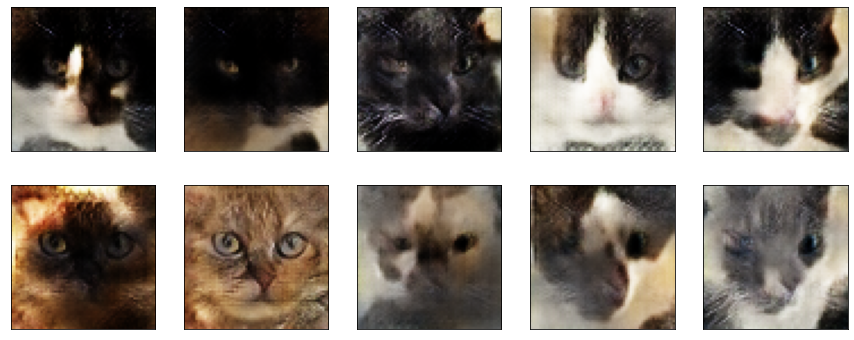

EPOCH 22
D loss real: 0.413		D loss fake: 0.382		G loss: 1.656


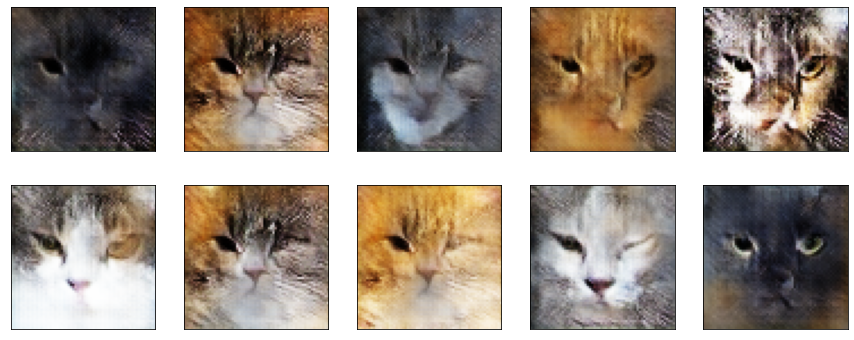

EPOCH 23
D loss real: 0.440		D loss fake: 0.530		G loss: 1.600


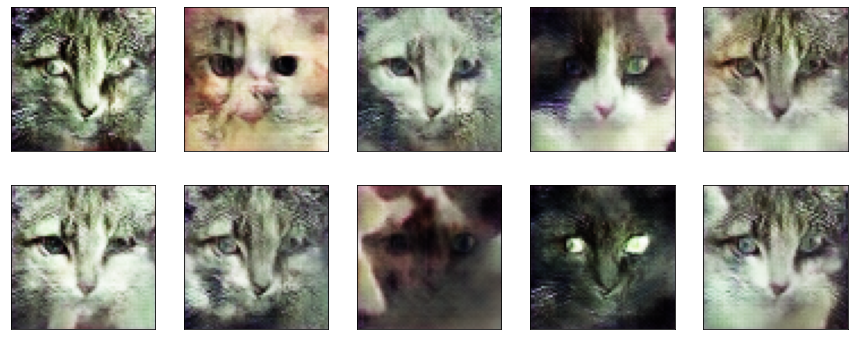

EPOCH 24
D loss real: 0.537		D loss fake: 0.622		G loss: 1.718


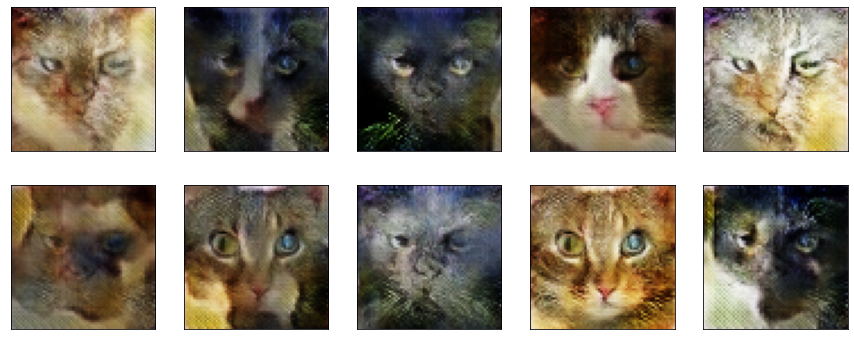

EPOCH 25
D loss real: 0.323		D loss fake: 0.367		G loss: 1.580


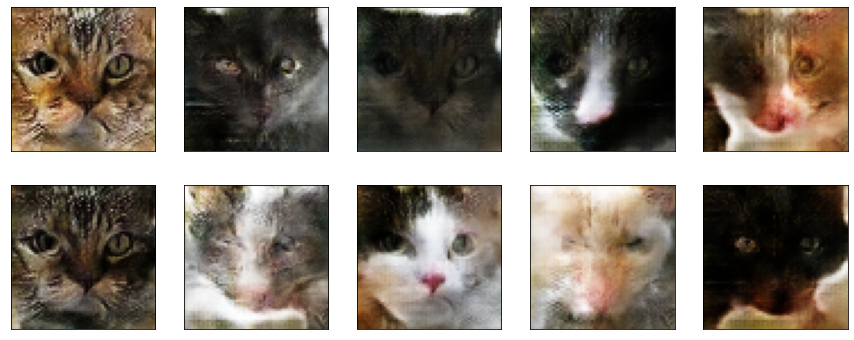

EPOCH 26
D loss real: 0.775		D loss fake: 0.360		G loss: 1.494


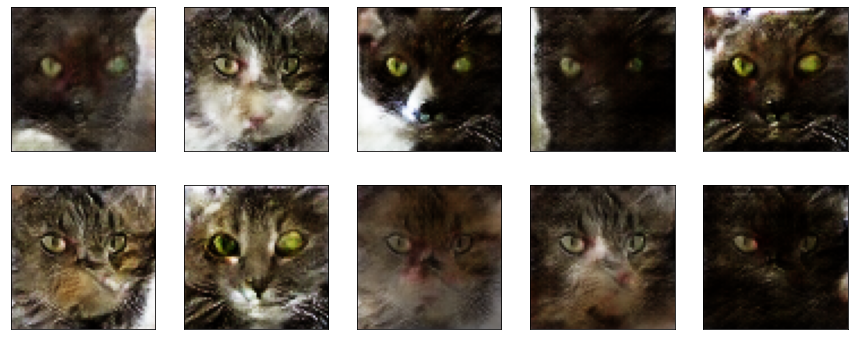

EPOCH 27
D loss real: 0.440		D loss fake: 0.347		G loss: 1.743


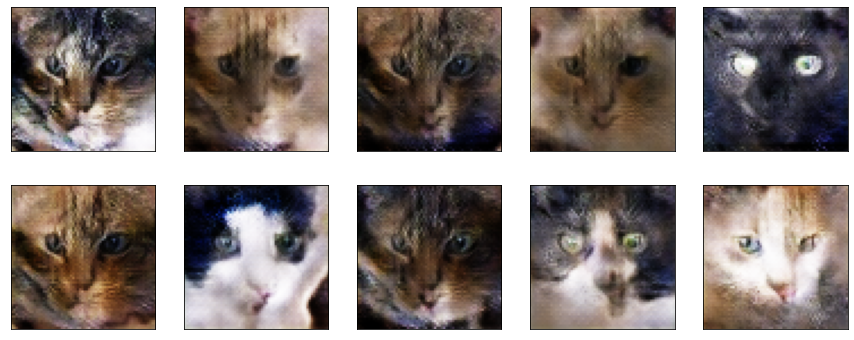

EPOCH 28
D loss real: 0.646		D loss fake: 0.440		G loss: 1.590


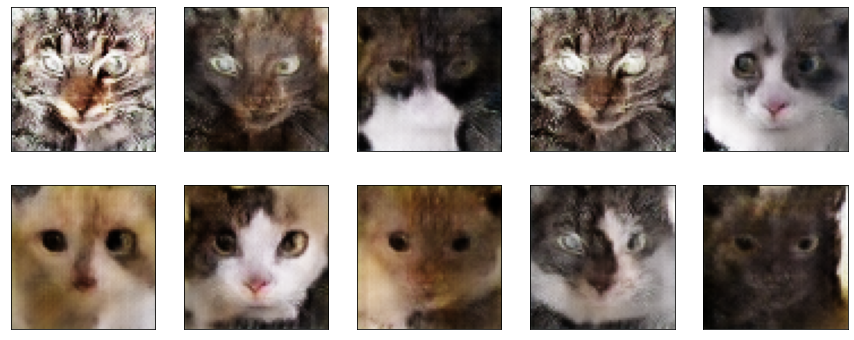

EPOCH 29
D loss real: 0.799		D loss fake: 0.539		G loss: 1.429


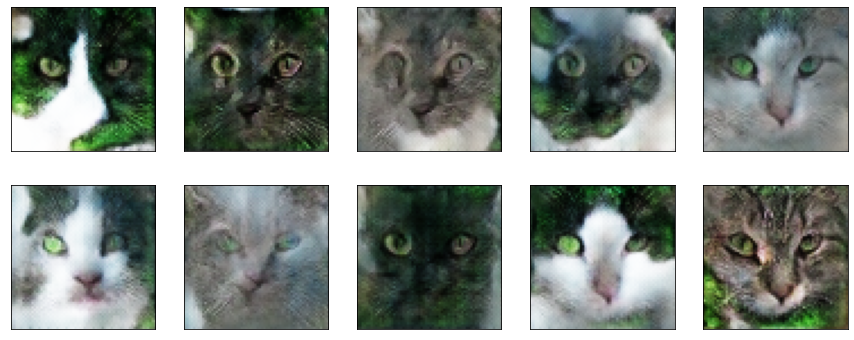

EPOCH 30
D loss real: 0.514		D loss fake: 0.516		G loss: 1.494


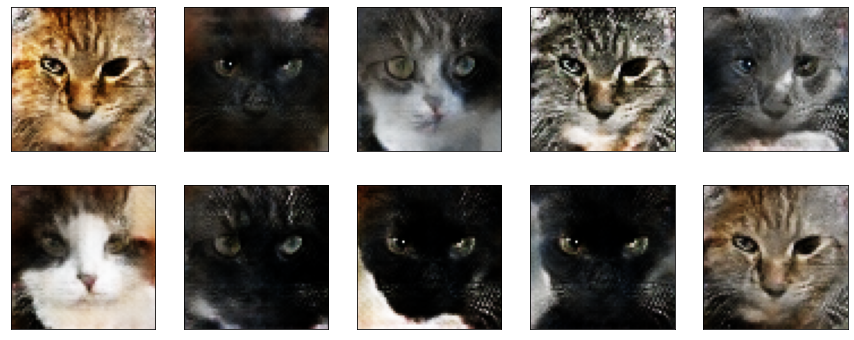

EPOCH 31
D loss real: 0.497		D loss fake: 0.350		G loss: 1.537


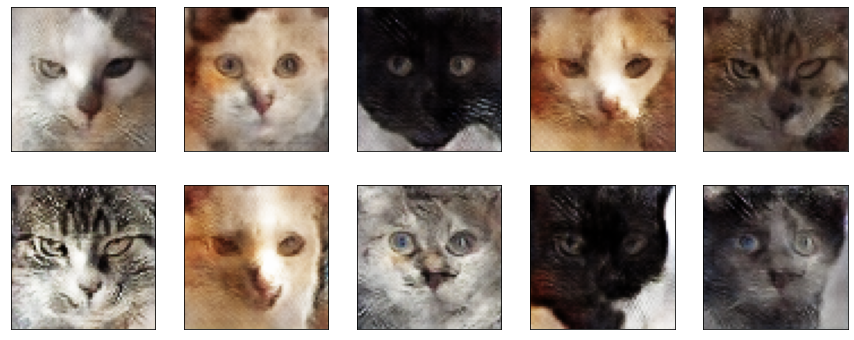

EPOCH 32
D loss real: 0.521		D loss fake: 0.683		G loss: 1.856


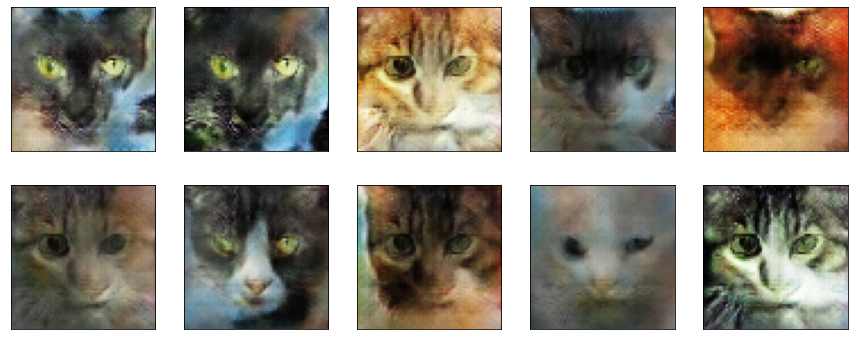

EPOCH 33
D loss real: 0.401		D loss fake: 0.448		G loss: 1.915


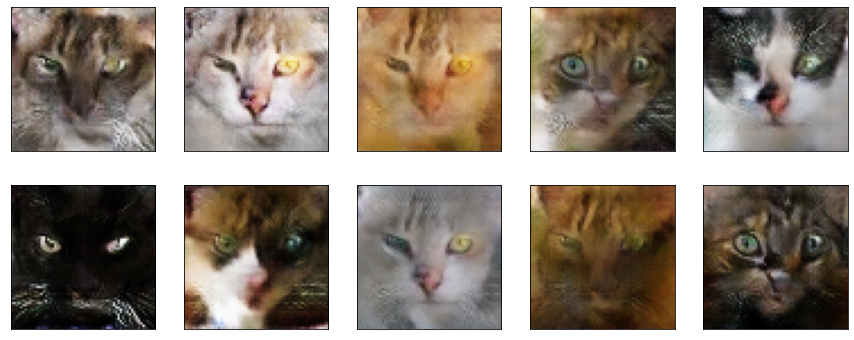

EPOCH 34
D loss real: 0.329		D loss fake: 0.279		G loss: 1.948


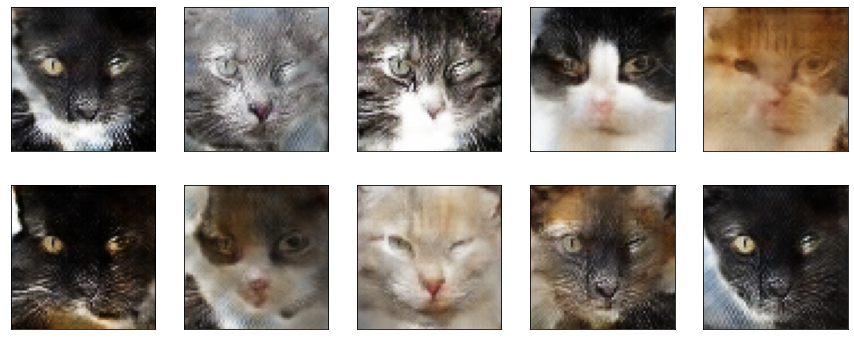

EPOCH 35
D loss real: 0.376		D loss fake: 0.333		G loss: 1.791


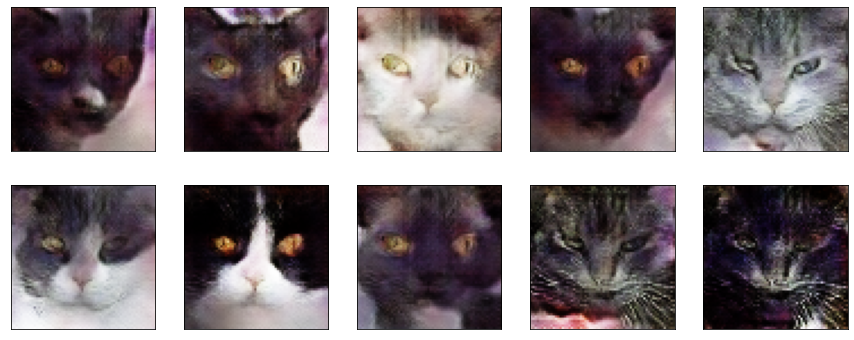

EPOCH 36
D loss real: 0.454		D loss fake: 0.377		G loss: 1.737


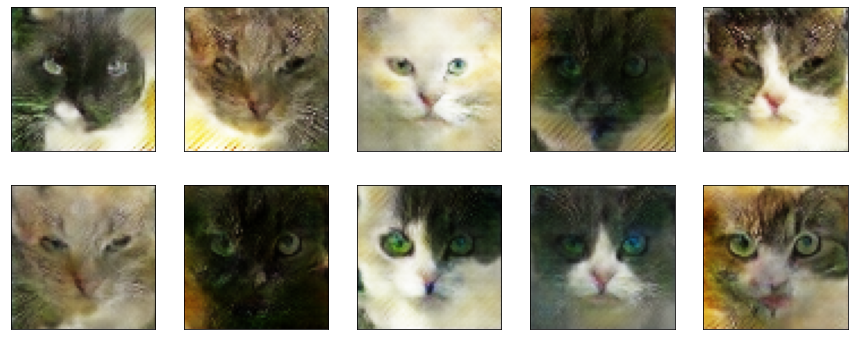

EPOCH 37
D loss real: 0.487		D loss fake: 0.371		G loss: 1.536


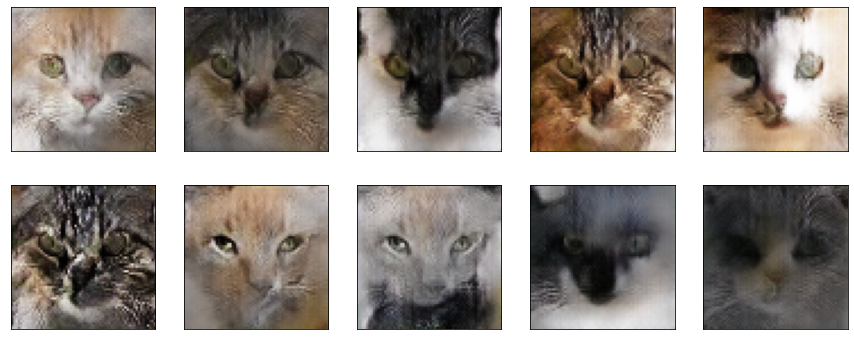

EPOCH 38
D loss real: 0.378		D loss fake: 0.376		G loss: 1.572


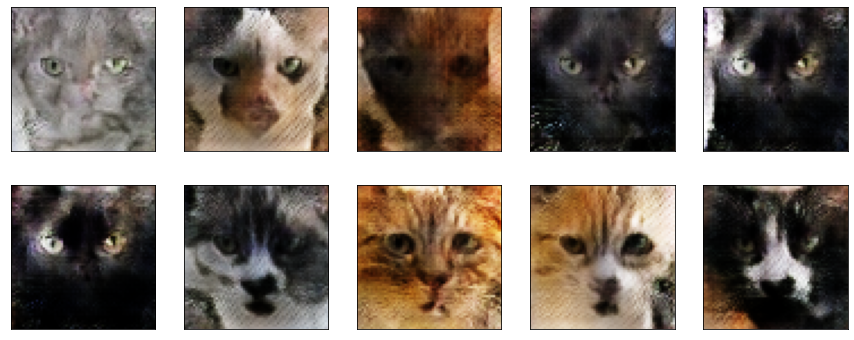

EPOCH 39
D loss real: 0.459		D loss fake: 0.257		G loss: 1.729


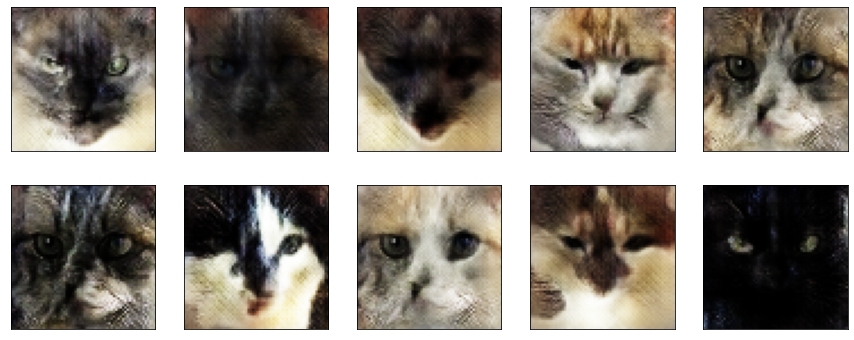

EPOCH 40
D loss real: 0.474		D loss fake: 0.420		G loss: 2.433


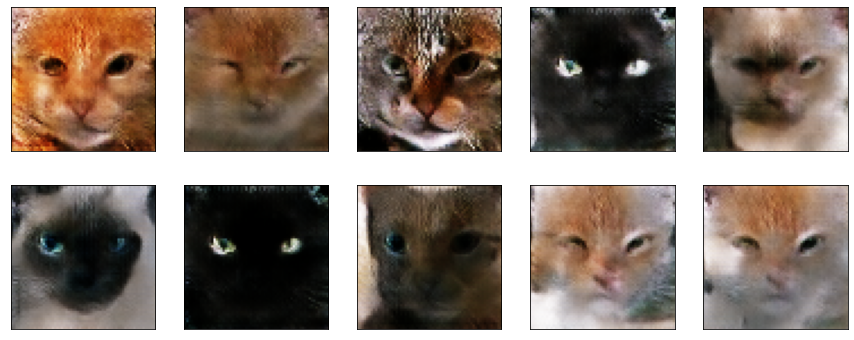

EPOCH 41
D loss real: 0.258		D loss fake: 0.353		G loss: 1.868


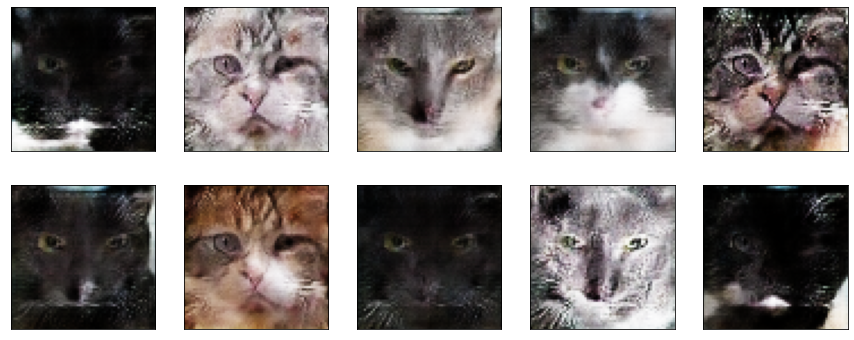

EPOCH 42
D loss real: 0.461		D loss fake: 0.450		G loss: 1.861


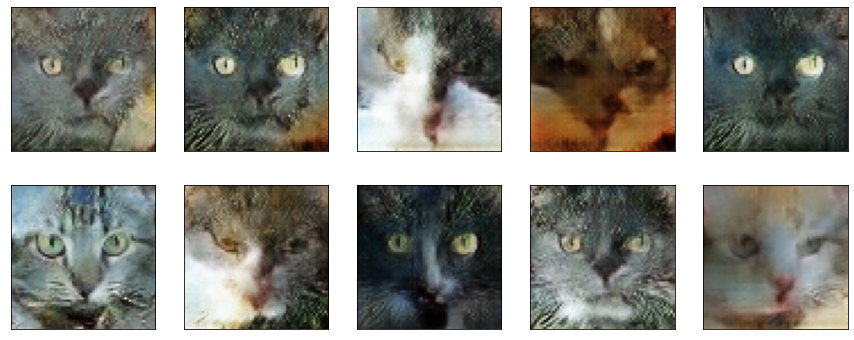

EPOCH 43
D loss real: 0.537		D loss fake: 0.498		G loss: 1.908


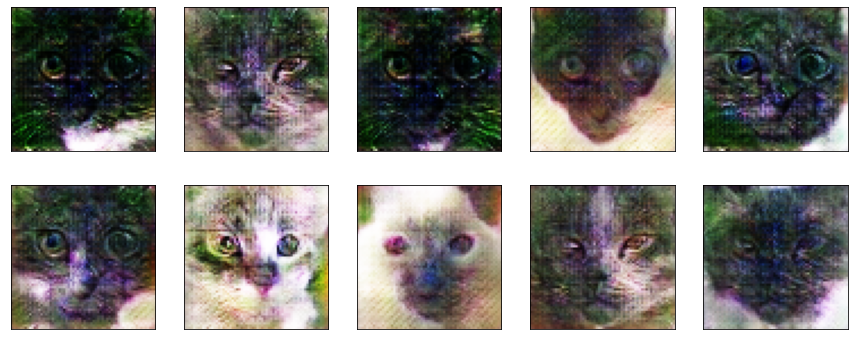

EPOCH 44
D loss real: 0.698		D loss fake: 0.295		G loss: 1.786


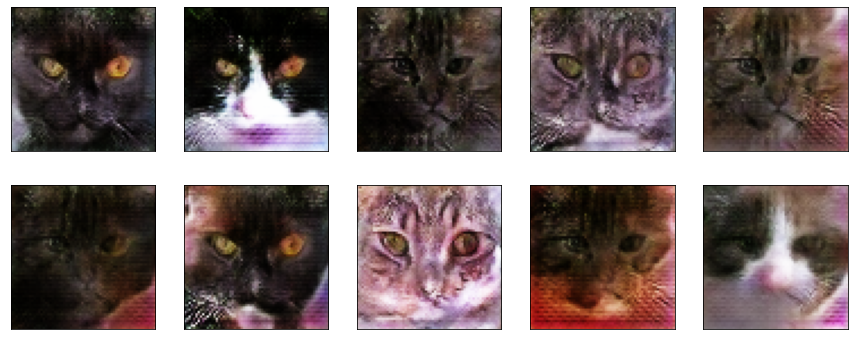

EPOCH 45
D loss real: 0.443		D loss fake: 0.539		G loss: 2.017


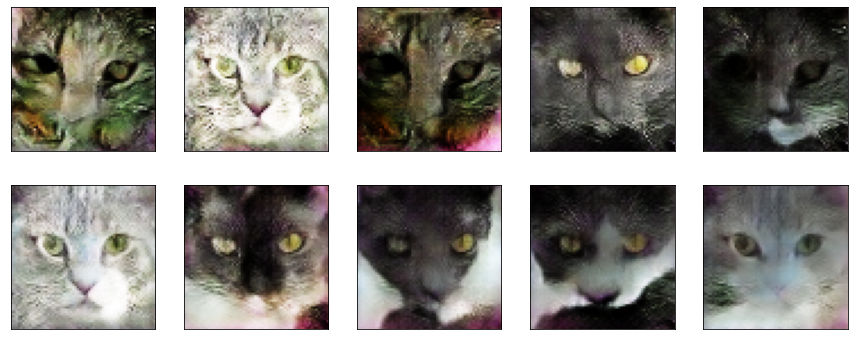

EPOCH 46
D loss real: 0.293		D loss fake: 0.314		G loss: 2.092


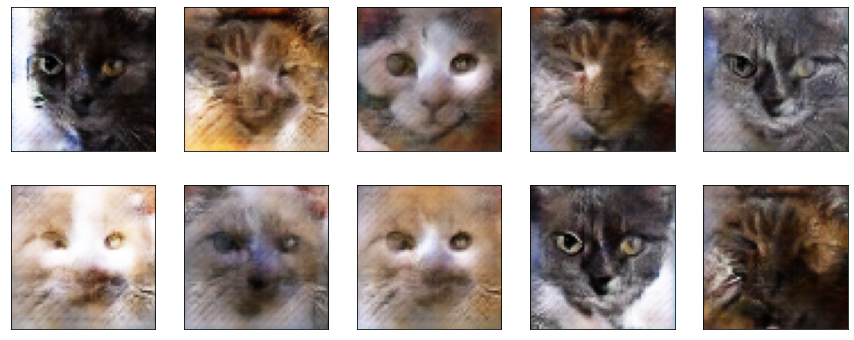

EPOCH 47
D loss real: 0.409		D loss fake: 0.362		G loss: 2.151


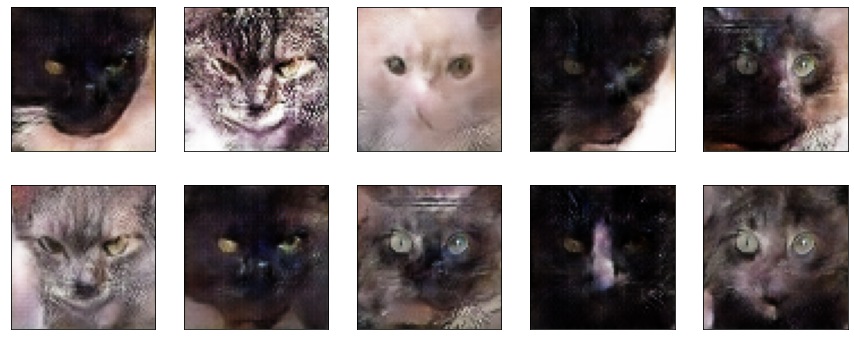

EPOCH 48
D loss real: 0.352		D loss fake: 0.431		G loss: 1.999


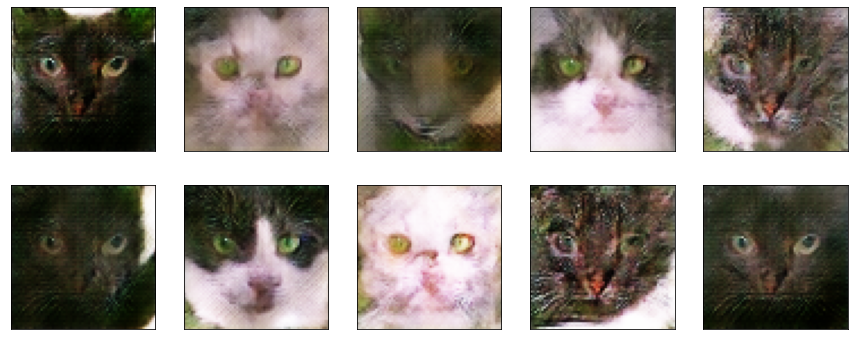

EPOCH 49
D loss real: 0.488		D loss fake: 0.261		G loss: 2.105


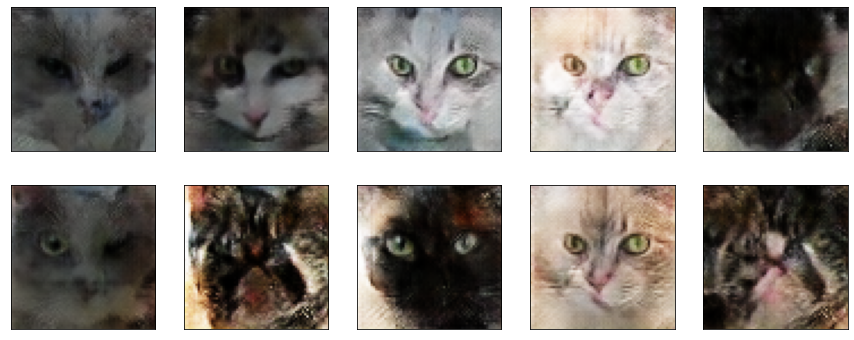

EPOCH 50
D loss real: 0.383		D loss fake: 0.326		G loss: 2.421


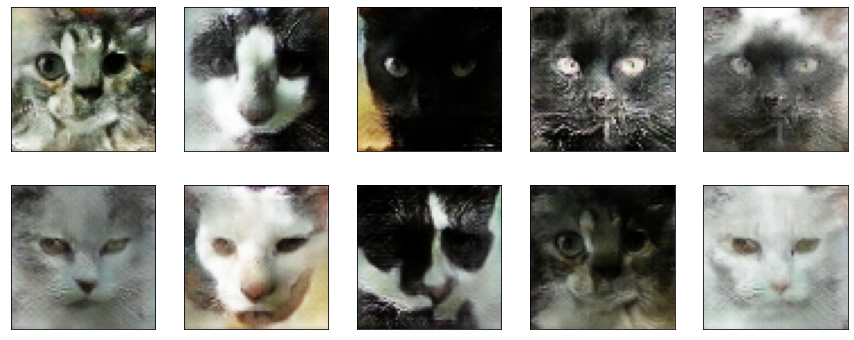

EPOCH 51
D loss real: 0.358		D loss fake: 0.402		G loss: 2.664


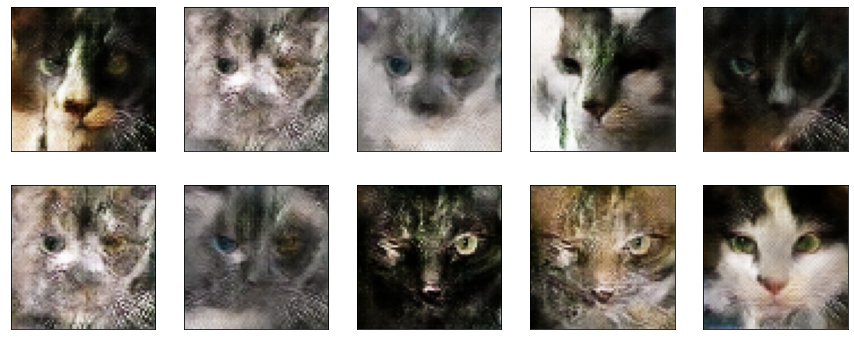

EPOCH 52
D loss real: 0.453		D loss fake: 0.474		G loss: 2.322


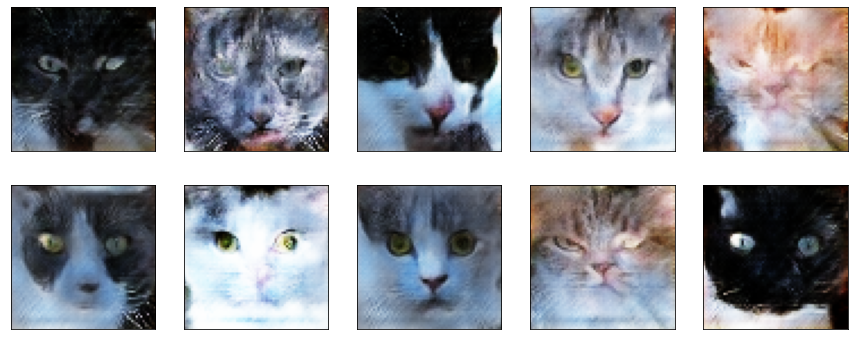

EPOCH 53
D loss real: 0.326		D loss fake: 0.434		G loss: 2.552


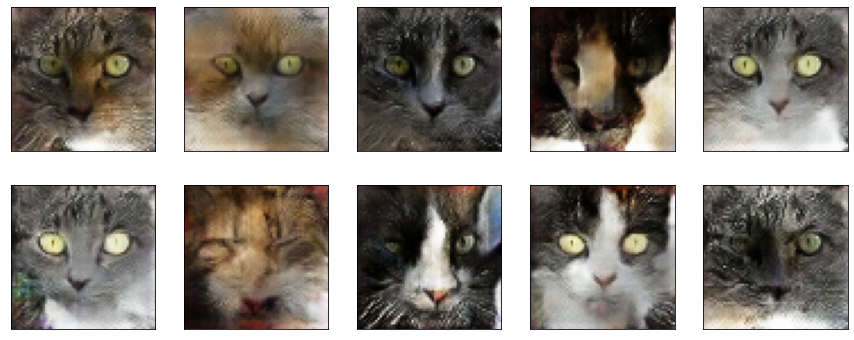

EPOCH 54
D loss real: 0.398		D loss fake: 0.266		G loss: 2.302


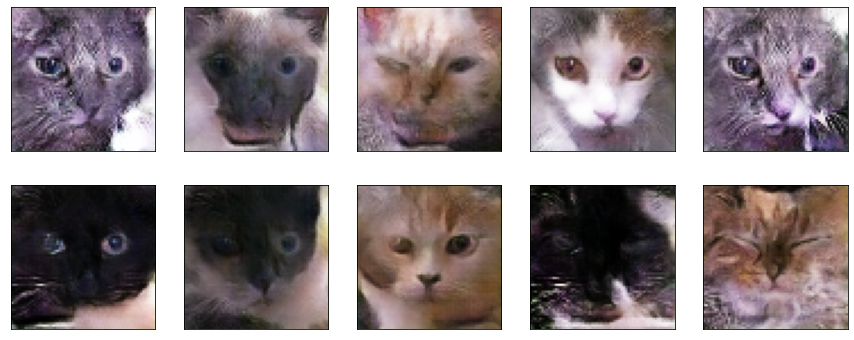

EPOCH 55
D loss real: 0.502		D loss fake: 0.453		G loss: 1.711


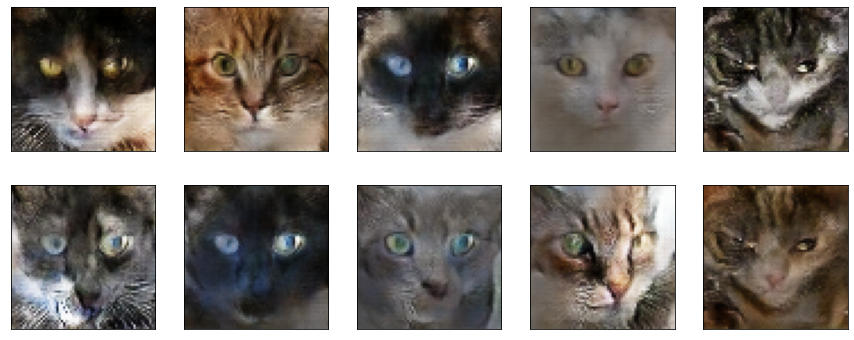

EPOCH 56
D loss real: 0.581		D loss fake: 0.553		G loss: 1.700


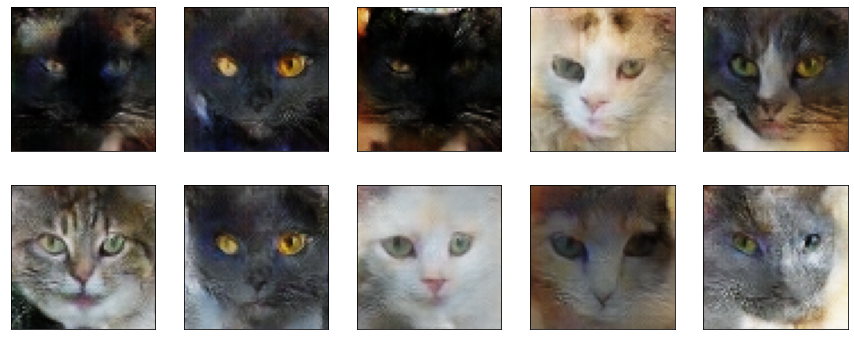

EPOCH 57
D loss real: 0.298		D loss fake: 0.370		G loss: 2.111


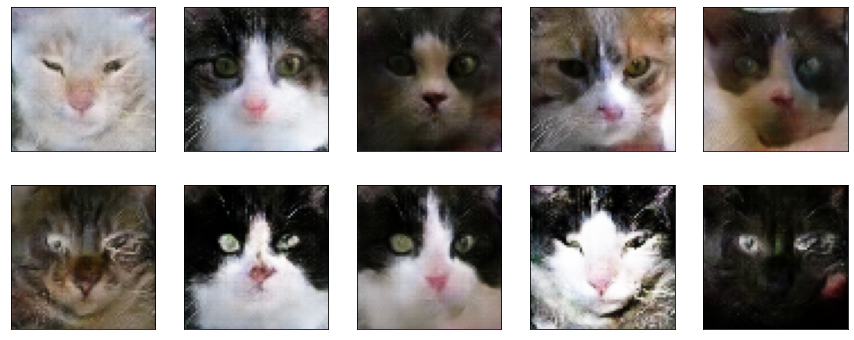

EPOCH 58
D loss real: 0.603		D loss fake: 0.371		G loss: 1.678


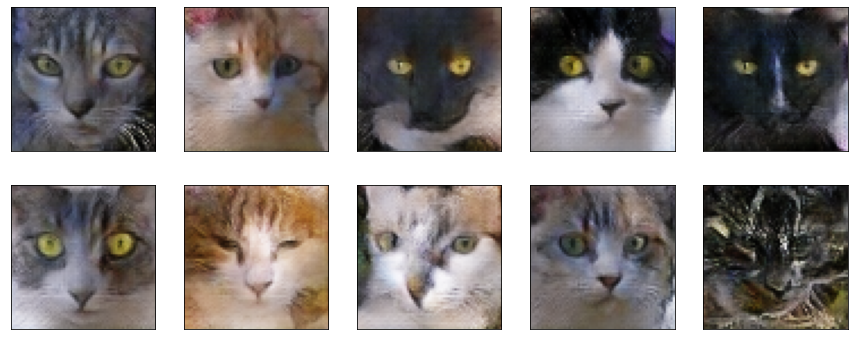

EPOCH 59
D loss real: 0.626		D loss fake: 0.273		G loss: 1.831


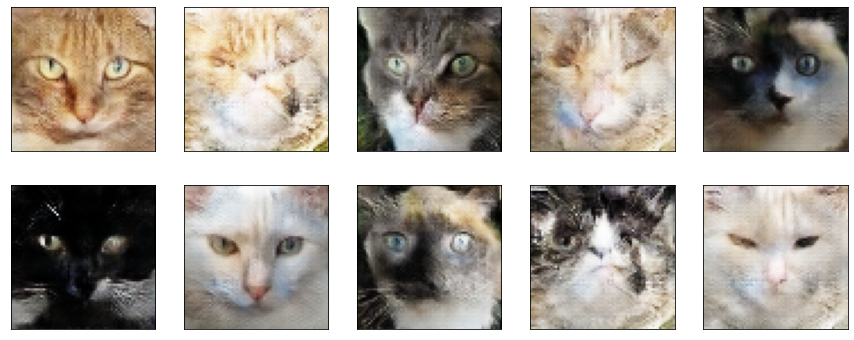

EPOCH 60
D loss real: 0.676		D loss fake: 0.355		G loss: 1.992


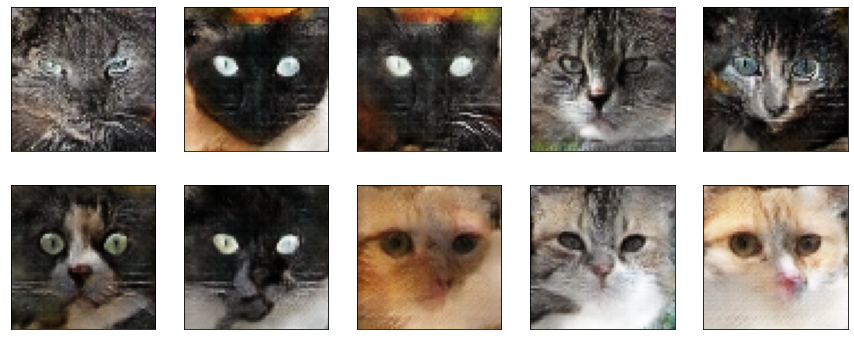

EPOCH 61
D loss real: 0.758		D loss fake: 0.437		G loss: 1.608


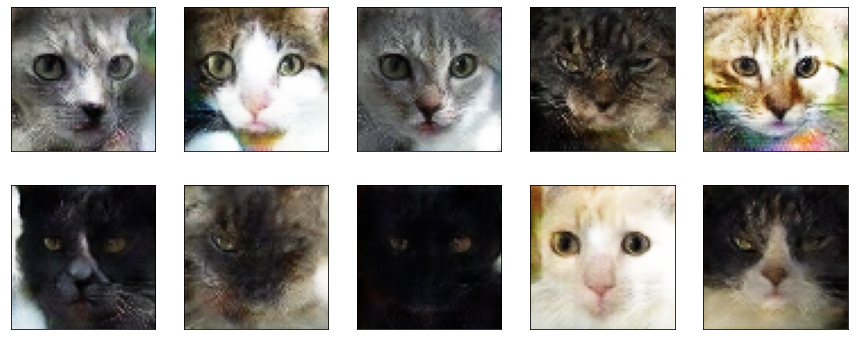

EPOCH 62
D loss real: 0.318		D loss fake: 0.230		G loss: 1.994


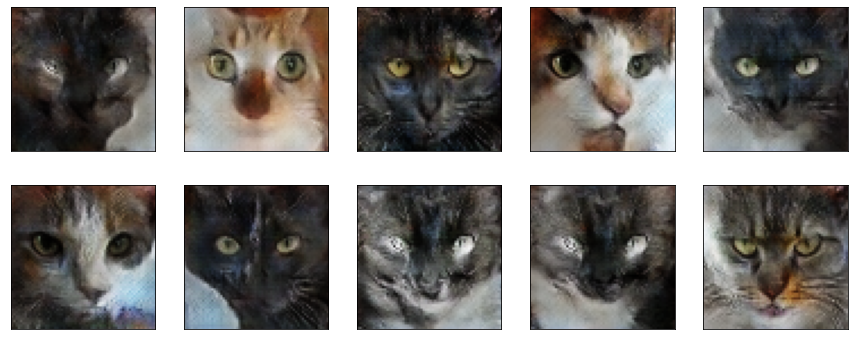

EPOCH 63
D loss real: 0.547		D loss fake: 0.363		G loss: 1.750


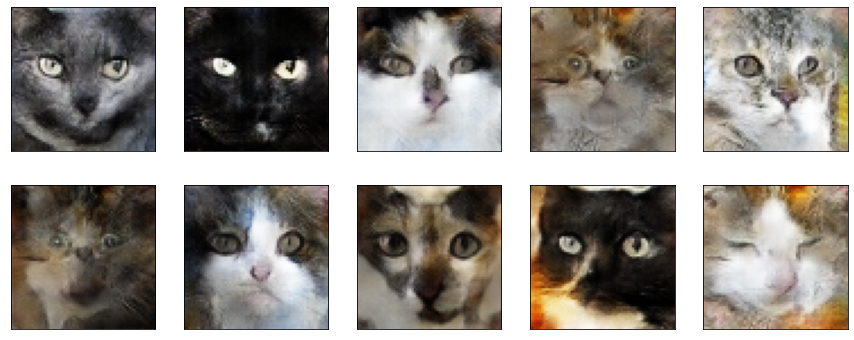

EPOCH 64
D loss real: 0.387		D loss fake: 0.601		G loss: 2.127


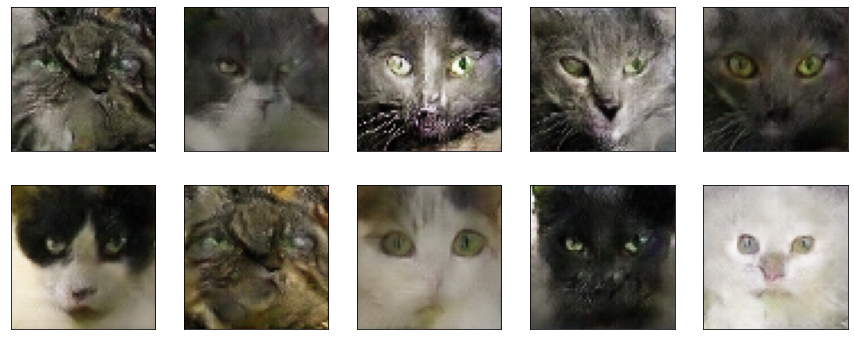

EPOCH 65
D loss real: 0.429		D loss fake: 0.367		G loss: 2.190


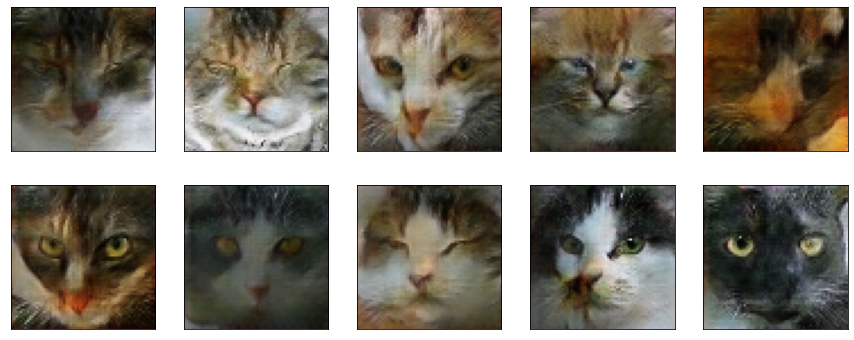

EPOCH 66
D loss real: 0.434		D loss fake: 0.287		G loss: 1.951


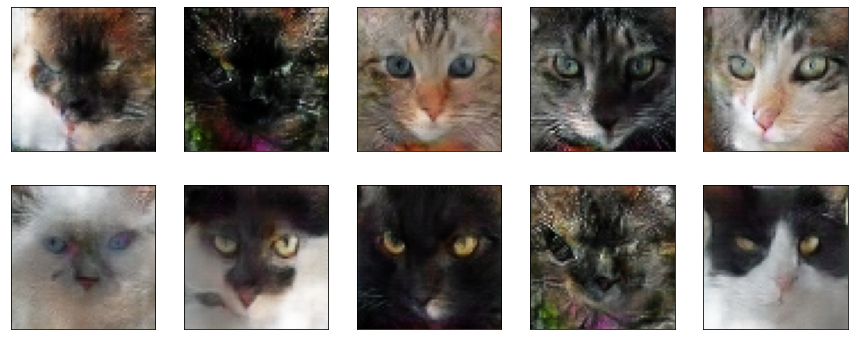

EPOCH 67
D loss real: 0.158		D loss fake: 0.574		G loss: 2.028


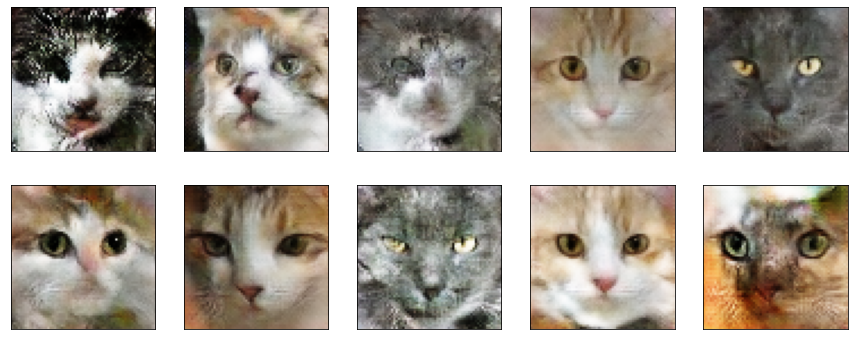

EPOCH 68
D loss real: 0.024		D loss fake: 0.004		G loss: 5.985


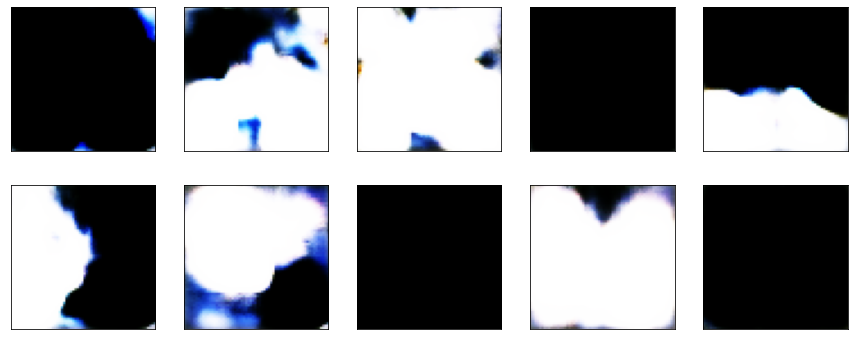

EPOCH 69
D loss real: 0.425		D loss fake: 0.341		G loss: 2.427


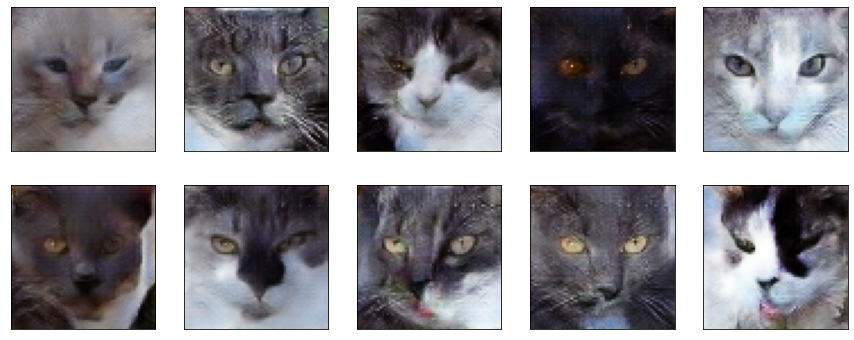

EPOCH 70
D loss real: 0.890		D loss fake: 0.293		G loss: 1.747


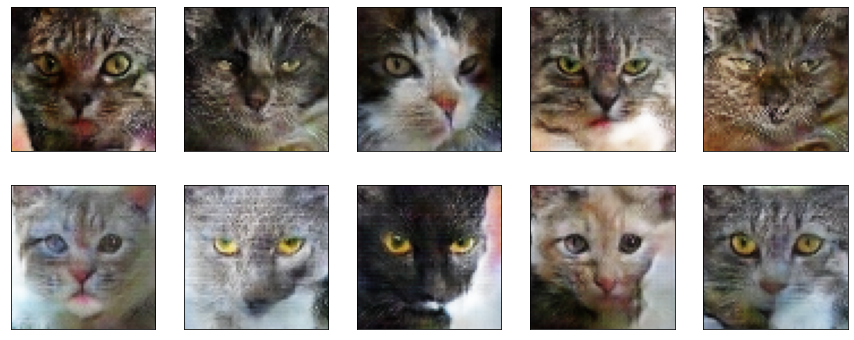

EPOCH 71
D loss real: 0.507		D loss fake: 0.311		G loss: 1.789


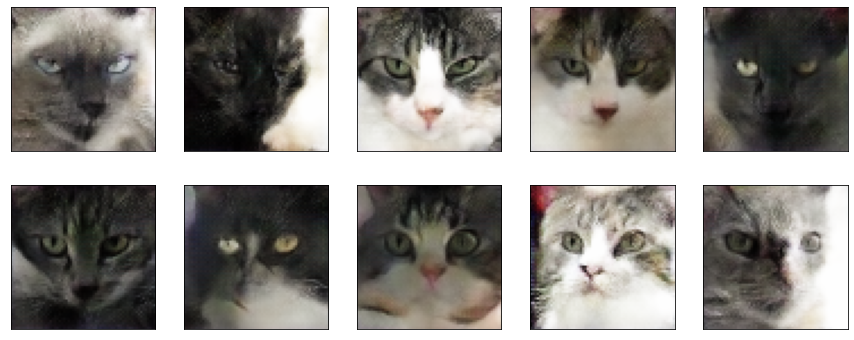

EPOCH 72
D loss real: 0.591		D loss fake: 0.378		G loss: 2.110


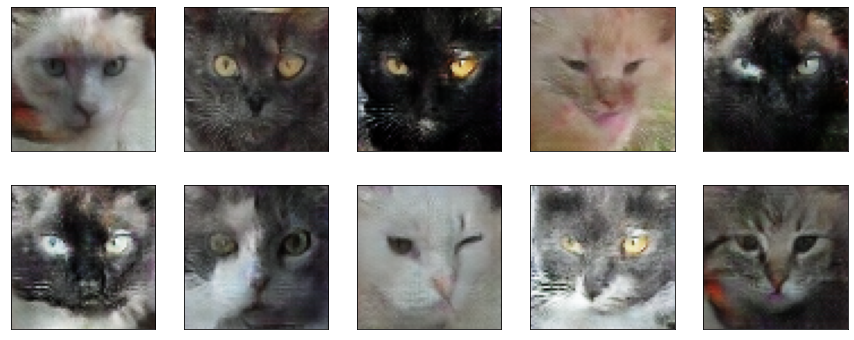

EPOCH 73
D loss real: 0.479		D loss fake: 0.219		G loss: 2.085


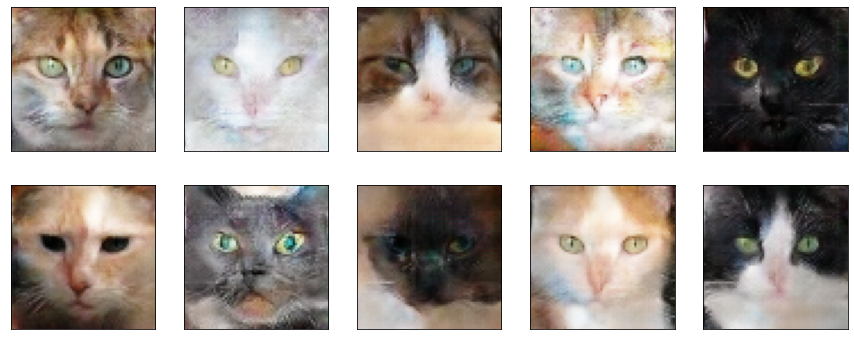

EPOCH 74
D loss real: 0.366		D loss fake: 0.442		G loss: 1.865


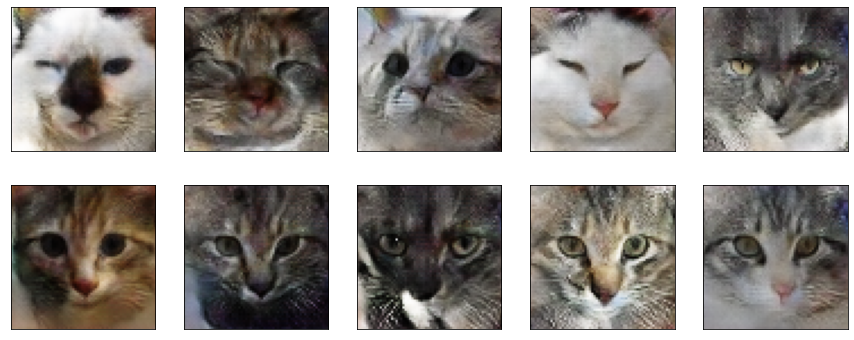

EPOCH 75
D loss real: 0.602		D loss fake: 0.274		G loss: 1.740


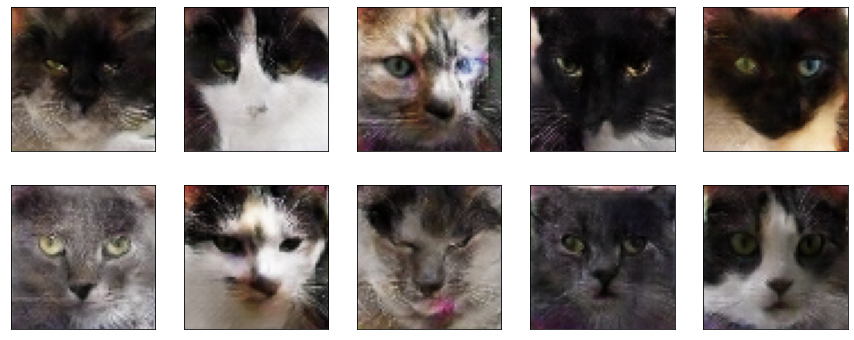

EPOCH 76
D loss real: 0.355		D loss fake: 0.366		G loss: 1.904


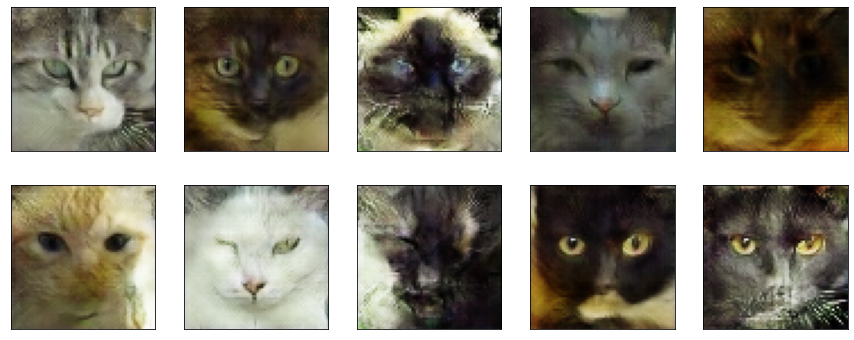

EPOCH 77
D loss real: 0.513		D loss fake: 0.261		G loss: 2.350


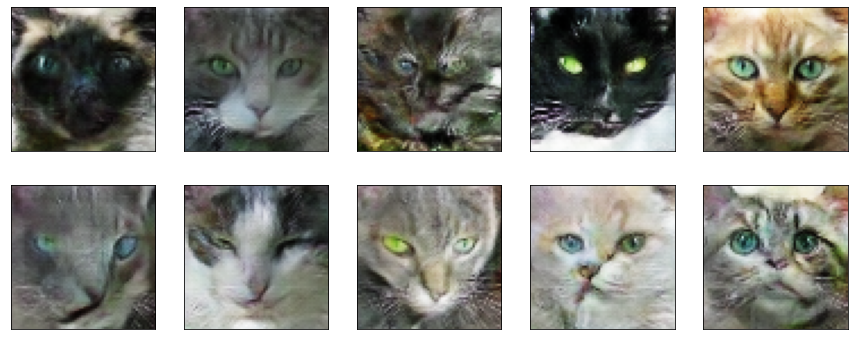

EPOCH 78
D loss real: 0.349		D loss fake: 0.475		G loss: 1.999


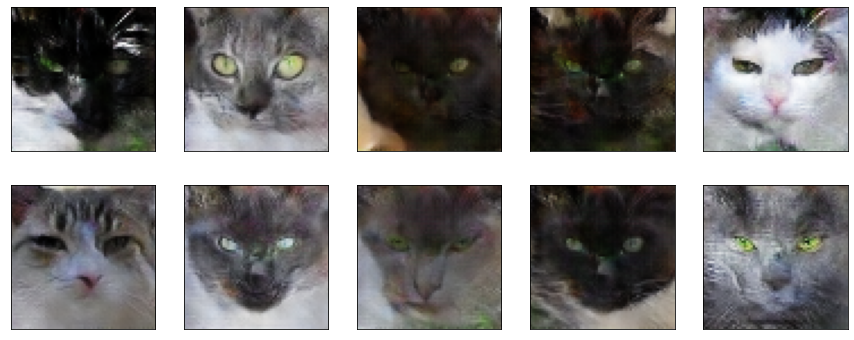

EPOCH 79
D loss real: 0.383		D loss fake: 1.059		G loss: 2.329


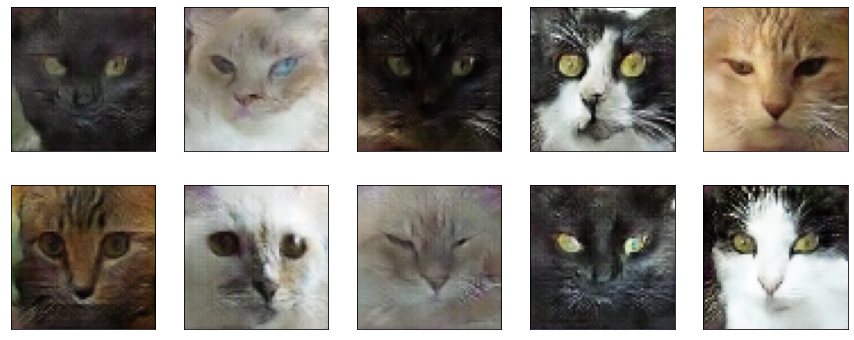

EPOCH 80
D loss real: 0.379		D loss fake: 0.308		G loss: 1.997


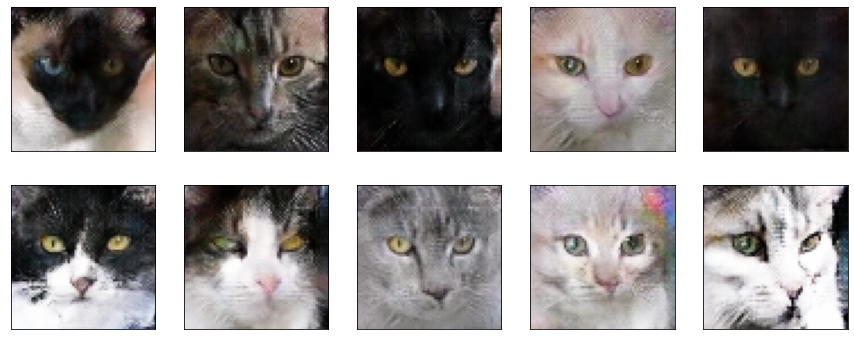

EPOCH 81
D loss real: 0.272		D loss fake: 0.345		G loss: 2.321


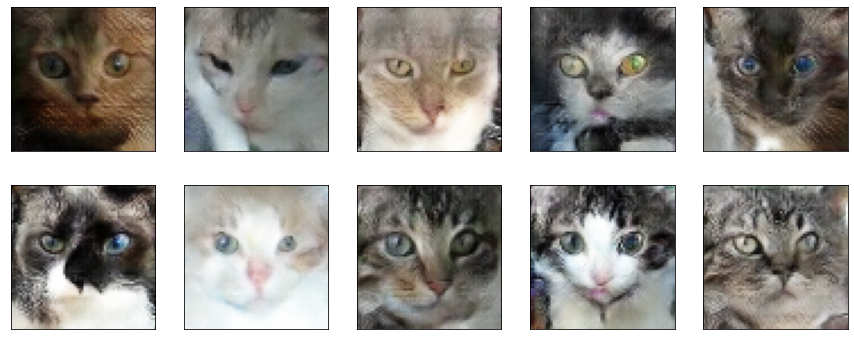

EPOCH 82
D loss real: 0.879		D loss fake: 0.225		G loss: 1.767


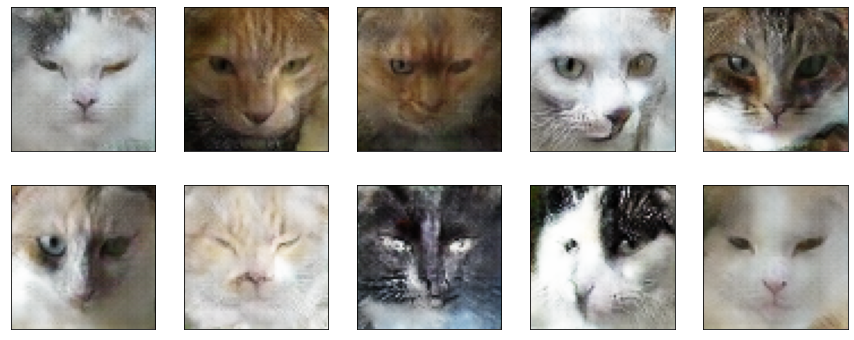

EPOCH 83
D loss real: 0.451		D loss fake: 0.510		G loss: 1.975


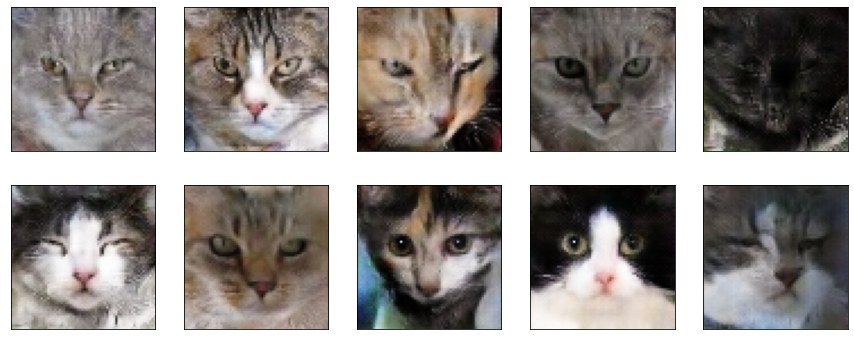

EPOCH 84
D loss real: 0.430		D loss fake: 0.230		G loss: 3.018


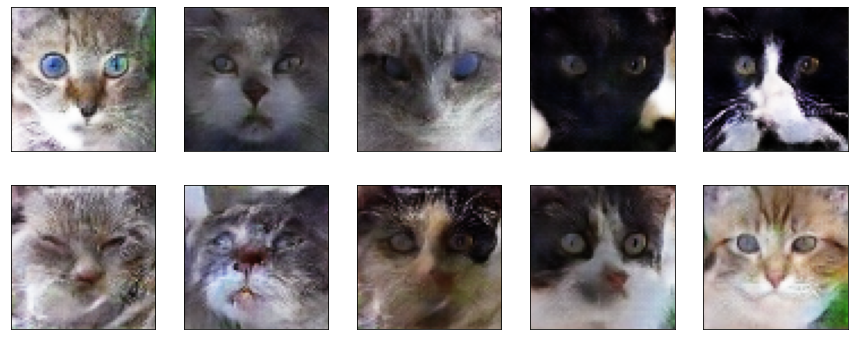

EPOCH 85
D loss real: 0.233		D loss fake: 0.415		G loss: 2.236


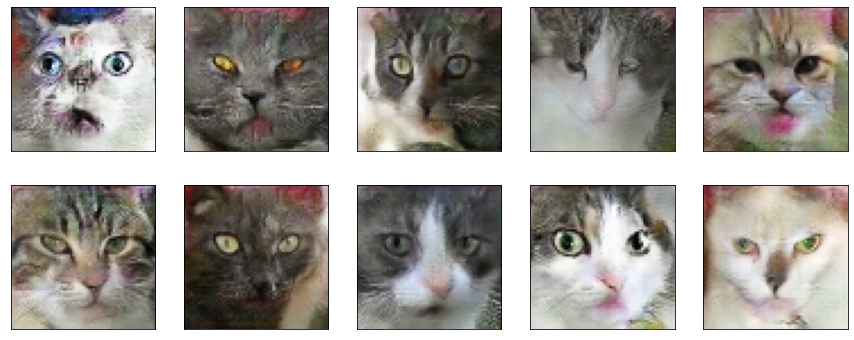

EPOCH 86
D loss real: 0.372		D loss fake: 0.234		G loss: 2.289


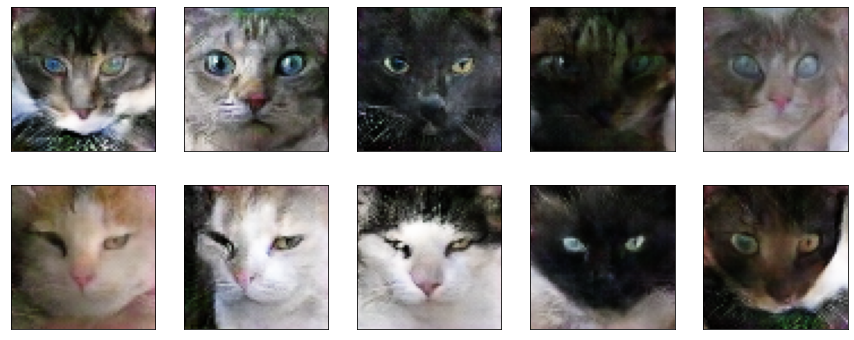

EPOCH 87
D loss real: 0.471		D loss fake: 0.387		G loss: 1.691


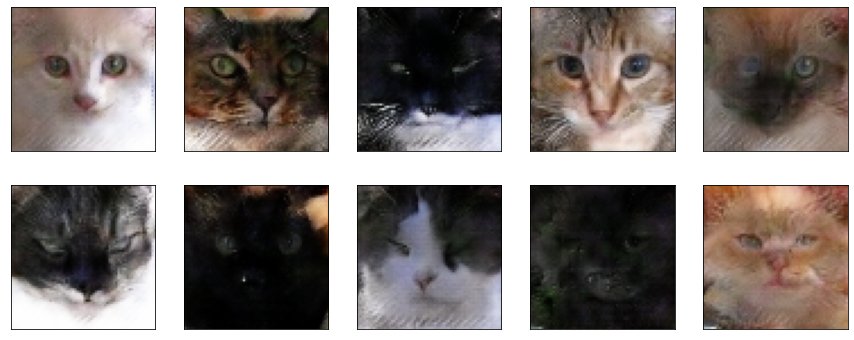

EPOCH 88
D loss real: 0.276		D loss fake: 0.454		G loss: 2.118


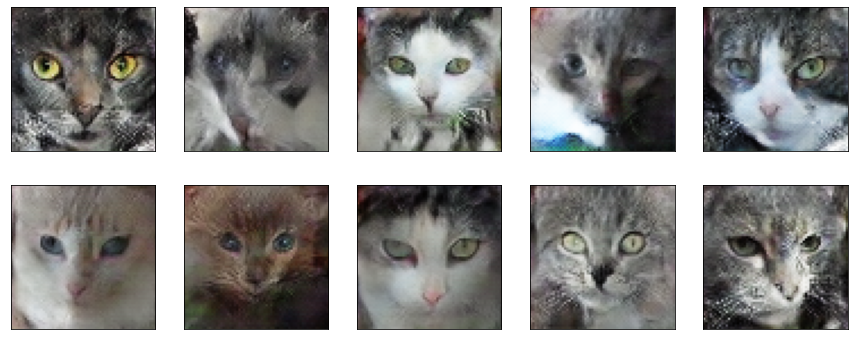

EPOCH 89
D loss real: 0.277		D loss fake: 0.380		G loss: 1.887


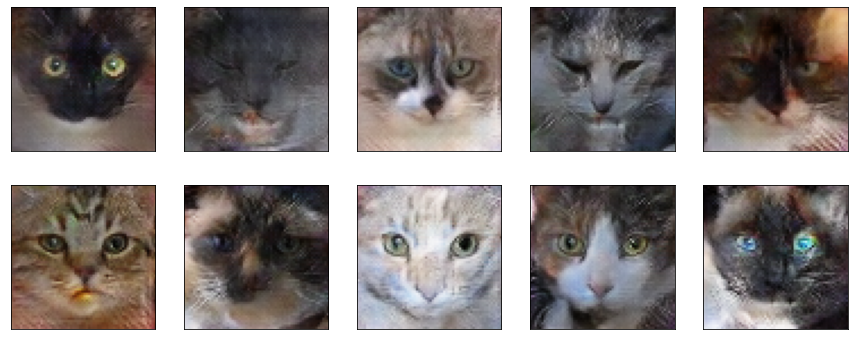

EPOCH 90
D loss real: 0.348		D loss fake: 0.291		G loss: 2.408


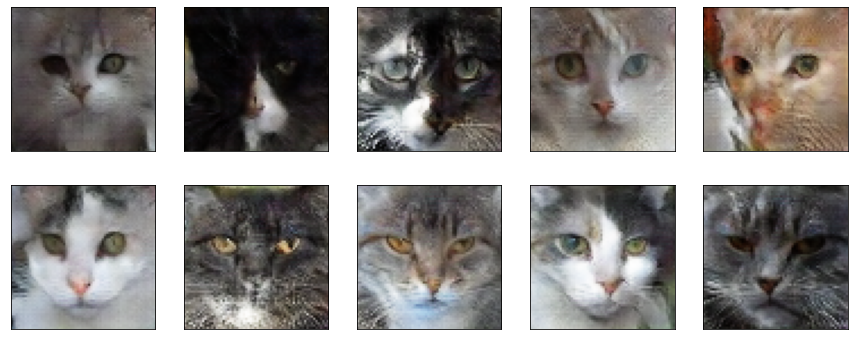

EPOCH 91
D loss real: 0.596		D loss fake: 0.461		G loss: 2.101


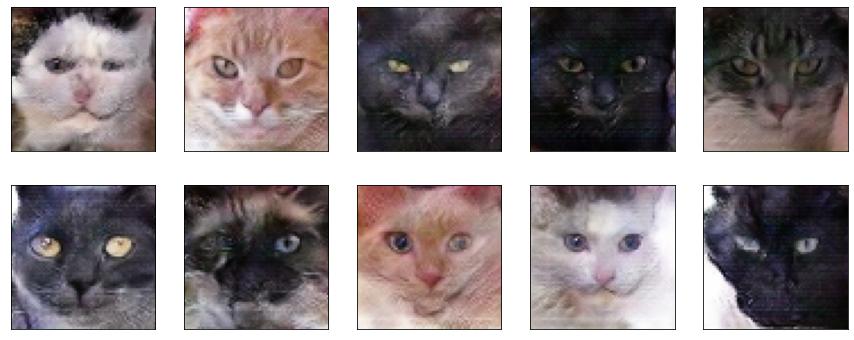

EPOCH 92
D loss real: 0.294		D loss fake: 0.274		G loss: 2.167


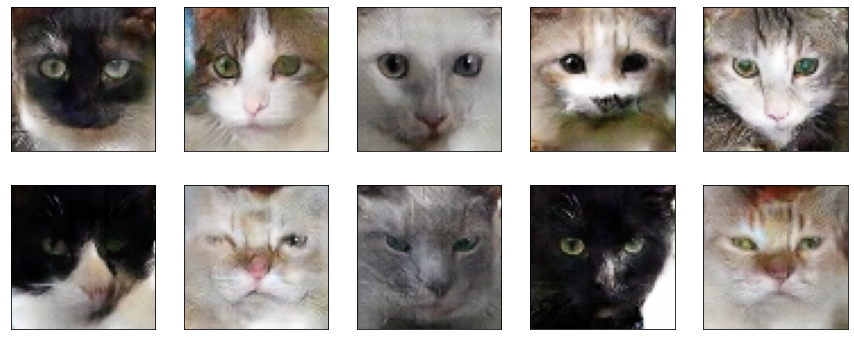

EPOCH 93
D loss real: 0.245		D loss fake: 0.463		G loss: 2.238


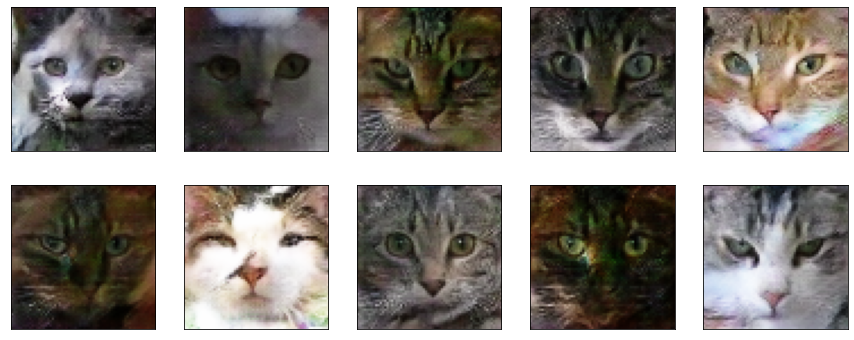

EPOCH 94
D loss real: 0.578		D loss fake: 0.437		G loss: 1.687


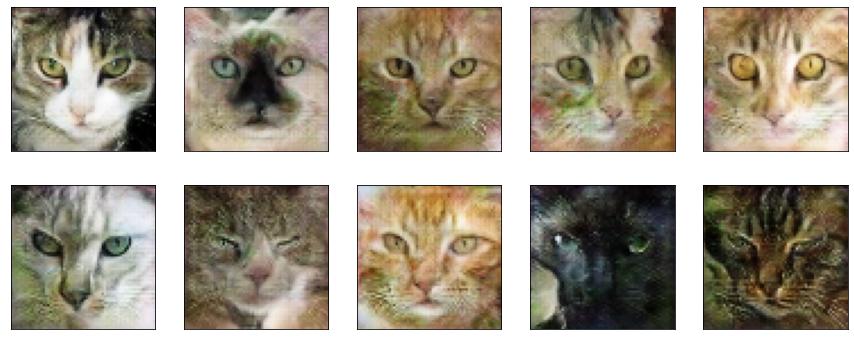

EPOCH 95
D loss real: 0.318		D loss fake: 0.262		G loss: 2.311


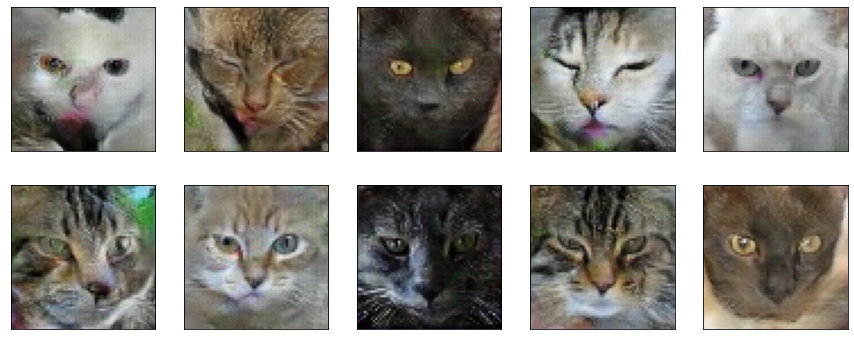

EPOCH 96
D loss real: 0.315		D loss fake: 0.263		G loss: 2.276


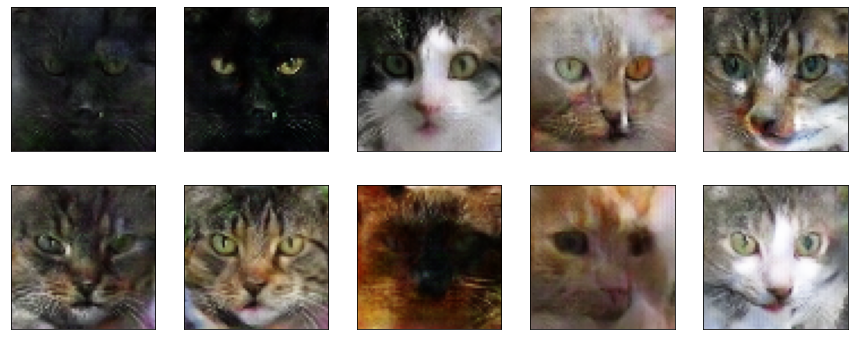

EPOCH 97
D loss real: 0.235		D loss fake: 0.212		G loss: 2.310


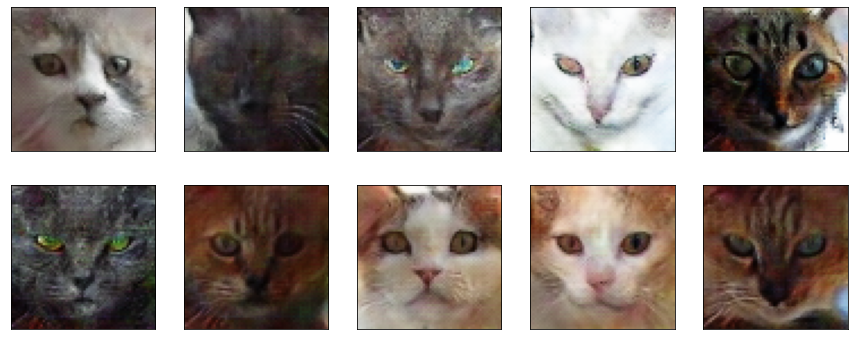

EPOCH 98
D loss real: 0.176		D loss fake: 0.232		G loss: 3.014


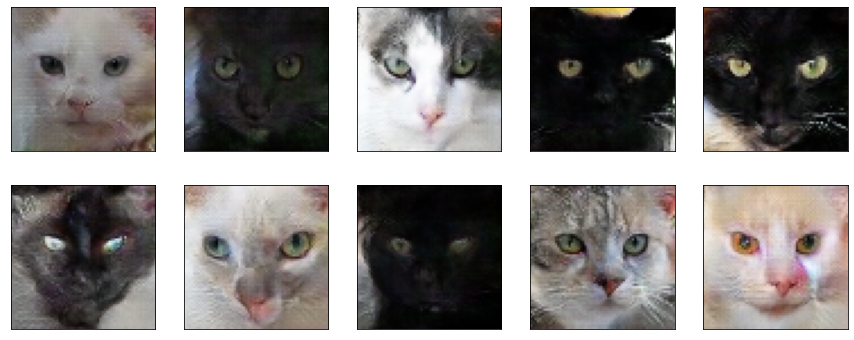

EPOCH 99
D loss real: 0.213		D loss fake: 0.292		G loss: 3.018


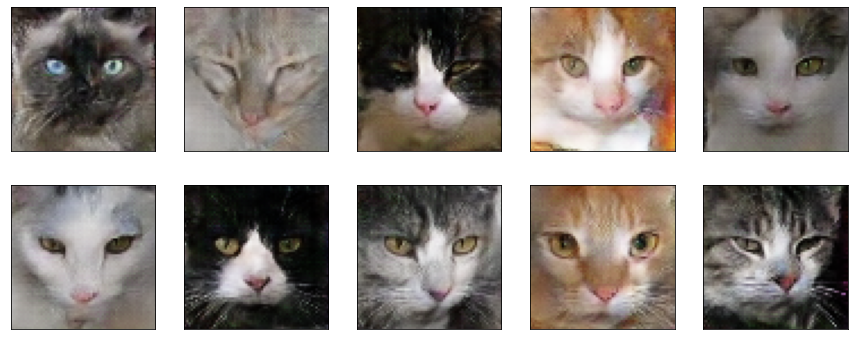

EPOCH 100
D loss real: 0.119		D loss fake: 0.420		G loss: 2.390


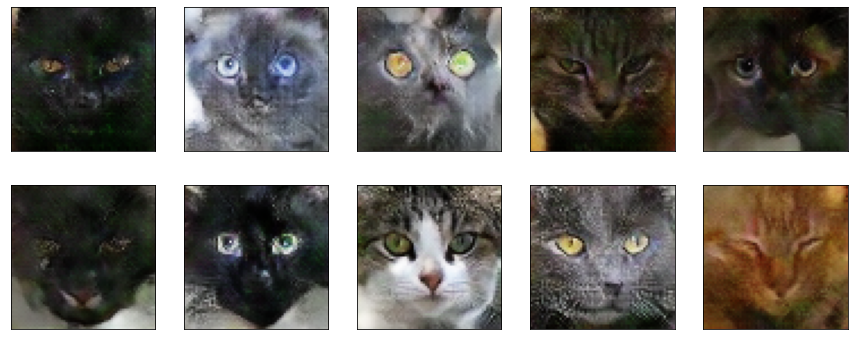

In [56]:
def trainModel(epochs, batchSize):
	discBatchSize = int(batchSize / 2)
	dLossRealList, dLossFakeList, dAccRealList, dAccFakeList, gLossList = [], [], [], [], []
 
	for epoch in range(0, epochs):
		for batch in range(0, int(data.shape[0] / batchSize)):
			# Train the discriminator model on fake and real samples separately
			X = randomSample(discBatchSize)
			y = np.ones((discBatchSize, 1))
			discLossReal, discAccReal = discriminator.train_on_batch(X, y)

			X = fakeImages(discBatchSize)
			y = np.zeros((discBatchSize, 1))
			discLossFake, discAccFake = discriminator.train_on_batch(X, y)
	 
			# Train the generator model
			X = latentPoints(batchSize)
			y = np.ones((batchSize, 1))
			genLoss = gan.train_on_batch(X, y)
	 
			# Use this output to see if there is convergence failure early on
			# print('D loss real: %.3f		D loss fake: %.3f		G loss: %.3f' % (discLossReal, discLossFake, genLoss))
		
		# Append stats
		dLossRealList.append(discLossReal)
		dLossFakeList.append(discLossFake)
		dAccRealList.append(discAccReal)
		dAccFakeList.append(discAccFake)
		gLossList.append(genLoss)

		# Print images
		print('EPOCH ' + str(epoch + 1))
		print('D loss real: %.3f		D loss fake: %.3f		G loss: %.3f' % (discLossReal, discLossFake, genLoss))
		drawPlot(2, 5)
	
	return dLossRealList, dLossFakeList, dAccRealList, dAccFakeList, gLossList

# Train model
dLossRealList, dLossFakeList, dAccRealList, dAccFakeList, gLossList = trainModel(100, 64)


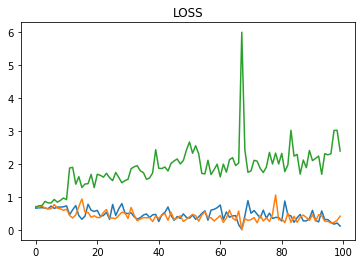

In [57]:
plt.title("LOSS")

plt.plot(dLossRealList, label='D loss real')
plt.plot(dLossFakeList, label='D loss fake')
plt.plot(gLossList, label='G loss')

plt.show()

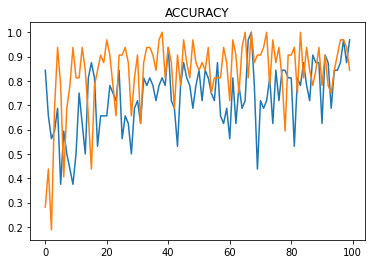

In [58]:
plt.title("ACCURACY")

plt.plot(dAccRealList, label='D accuracy real')
plt.plot(dAccFakeList, label='D accuracy fake')

plt.show()

From the graphs one can see that the model did not stabilize very much during the training, especially generator. Maybe more epochs would be needed, or including more techniques for stabilizing the model. For this checkpoint it is not important for the model to be as stabilized as possible, since it will still undergo many changes - the model needs to be turned into a conditional GAN and I would like it to work with pictures of higher resolution which means adding more convolutional layers. Since optimizing the parameters is pretty time consuming I will do it once the model is stable. For now it is important that the model is able to converge to pretty realistic looking cats. At one point the model even managed to resurrect my long gone cat, so I consider that a success.

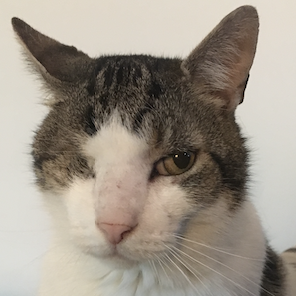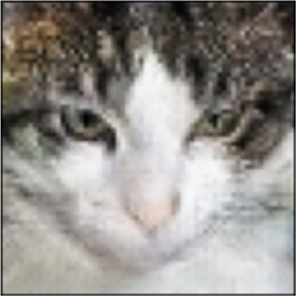

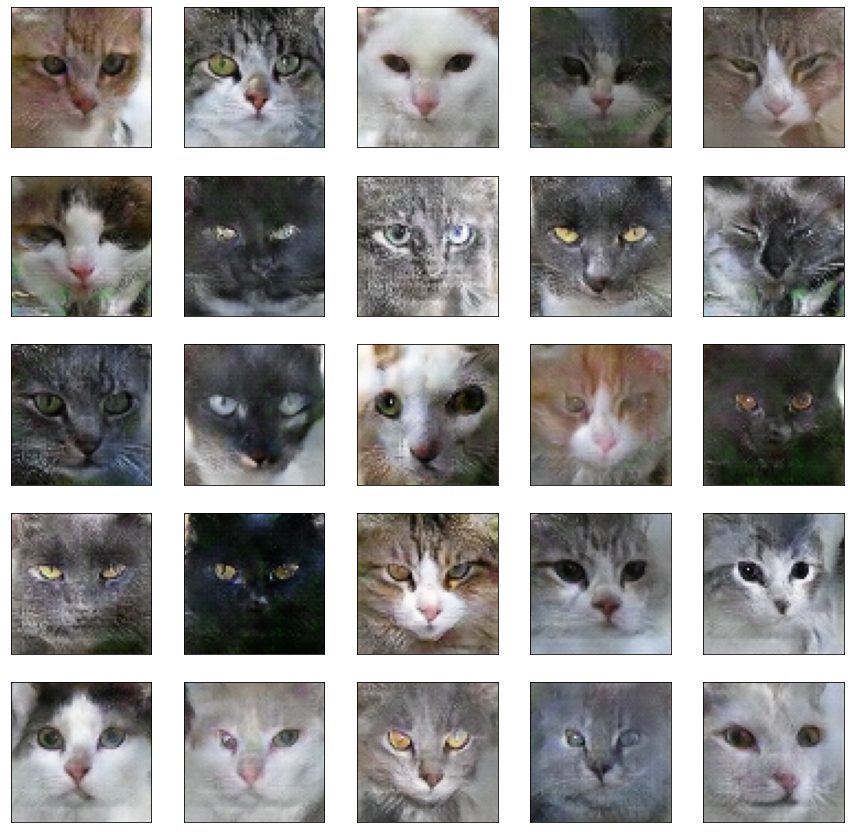

In [73]:
drawPlot(5, 5)

In [70]:
generator.save('generator.h5')
discriminator.save('discriminator.h5')
gan.save('gan.h5')